In [232]:
import matplotlib
%matplotlib inline
import torch
import torch.nn as nn
import torch.optim as optim
from torch.optim import lr_scheduler
import torch.backends.cudnn as cudnn
from torch.utils.data import DataLoader, Dataset
import numpy as np
import torchvision
from torchvision import datasets, models, transforms
import matplotlib.pyplot as plt
import time
import os
from PIL import Image
from tempfile import TemporaryDirectory
from collections import Counter
import timm
from tqdm.notebook import tqdm
import random
from sklearn.metrics import confusion_matrix
import seaborn as sns
import csv

cudnn.benchmark = True
plt.ion()   # interactive mode

In [2]:
class CustomImageDataset(Dataset):
    def __init__(self, root_dir, data_filter=None, transform=None, target_transform=None):
        self.img_paths = []
        self.transform = transform # transformations for images
        self.target_transform = target_transform # transformations for labels
        self.labels = []

        # Recursive function to find all images in a directory
        def find_images(directory):
            image_paths = []

            for root, dirs, files in os.walk(directory):
                for file in files:
                    if file.endswith('.tif'):
                        image_path = os.path.join(root, file)   
                        label = os.path.basename(os.path.dirname(os.path.dirname(image_path)))  # Extract label from two levels above
                        if data_filter is None or data_filter(label):
                            image_paths.append(image_path)
                            if "0R" in label:
                                self.labels.append(0.)
                            elif "1R" in label:
                                self.labels.append(1.)
                            elif "2R" in label:
                                self.labels.append(2.)
                            elif "3R" in label:
                                self.labels.append(3.)

            return image_paths

        # Iterate through each subdirectory
        for subdirectory in os.listdir(root_dir):
            subdirectory_path = os.path.join(root_dir, subdirectory)

            # Check if the item in the root directory is a directory
            if os.path.isdir(subdirectory_path):
                # Find all images in the subdirectory (including nested subdirectories)
                new_image_paths = find_images(subdirectory_path)

                # Extend image paths
                self.img_paths.extend(new_image_paths)   

    def __len__(self):
        return len(self.img_paths)

    def __getitem__(self, idx):
        img_path = self.img_paths[idx]
        image = Image.open(img_path)
        
        label = self.labels[idx]
        if self.transform:
            image = self.transform(image)
        if self.target_transform:
            label = self.target_transform(label)
            
        return image, label, img_path

# Define data transformations to prevent bias (the order of transforms is important)
train_transforms = transforms.Compose([
    transforms.RandomHorizontalFlip(p=0.5), # 50% of photos will be flipped
    transforms.RandomVerticalFlip(p=0.5),
    transforms.RandomRotation(degrees=(-45, 45), fill=127), # Rotate randomly between -45 and 45 degrees, fill with grey
    transforms.ToTensor(),
    transforms.Normalize(0.5, 0.5) # (pixel_val - 0.5) / 0.5
    # transforms.Normalize(0.5026, 0.0424)
])

val_transforms = transforms.Compose([
    transforms.ToTensor(),
    transforms.Normalize(0.5, 0.5) # (pixel_val - 0.5) / 0.5
    # transforms.Normalize(0.5026, 0.0424)
])

test_transforms = transforms.Compose([
    transforms.Resize((1024, 1024)),
    transforms.ToTensor(),
    transforms.Normalize(0.5, 0.5) # (pixel_val - 0.5) / 0.5
    # transforms.Normalize(0.5026, 0.0424)
])

def transform_label(label):
    return f"{int(label)}R"

holdout = ["12_4009_2R", "07_4001_3R", "33_1012_1_0R", "19_1021_1_1R1a"] # validation folders
def filter_val(x):
    for h in holdout:
        if x.find(h) != -1:
            return True
    return False

# without filtering
# dataset = CustomImageDataset(root_dir='/home/datasets/dataset_biopsies_small2', transform=data_transforms)
# train_size = int(0.8 * len(dataset))
# val_size = len(dataset) - train_size
# train_dataset, val_dataset = torch.utils.data.random_split(dataset, [train_size, val_size]) 

train_dataset = CustomImageDataset(root_dir='/home/datasets/dataset_biopsies_small2', data_filter= lambda x: not filter_val(x), transform=train_transforms)
val_dataset = CustomImageDataset(root_dir='/home/datasets/dataset_biopsies_small2', data_filter= lambda x: filter_val(x), transform=val_transforms)
test_dataset = CustomImageDataset(root_dir='/home/code/dataset_test', transform=test_transforms)

dataloaders = {
    # larger batch size requires more computational power, but it generalizes well so it can predict well on new images
    'train': DataLoader(train_dataset, batch_size=4, shuffle=True),
    'val': DataLoader(val_dataset, batch_size=4, shuffle=False),
    'test': DataLoader(test_dataset, batch_size=4, shuffle=False)
}

# uzmi zadnju epohu od treninga i pokazi kako se modeli ponasaju za validacijske (nevidene) slike => densenet bolji
# onda uzmi i test (dehidrirane slike, drugacije slike) set i pokazi kako se modeli ponasaju, ucitaj model iz zadnje epohe => resnet bolji

In [8]:
# Check the total number of images in the train dataset
total_train_images = len(train_dataset)
print(f"Total number of training images: {total_train_images}")

# Check the distribution of labels
labels = [label for _, label, _ in train_dataset]
label_counts = Counter(labels)

sorted_label_counts = sorted(label_counts.items(), key=lambda x: x[0])
  
for label, count in sorted_label_counts:
    print(f"Label {transform_label(label)}: {count} samples")

# dataloader info
print()
training_total_batches = len(dataloaders['train'])
print(f"Total number of training batches: {training_total_batches}")
images_per_batch = dataloaders['train'].batch_size
print(f"Number of images per training batch: {images_per_batch}")
print("-------------------------------")

# Check the total number of images in the validation dataset
total_val_images = len(val_dataset)
print(f"Total number of validation images: {total_val_images}")

# Check the distribution of labels
labels = [label for _, label, _ in val_dataset]
label_counts = Counter(labels)

sorted_label_counts = sorted(label_counts.items(), key=lambda x: x[0])
  
for label, count in sorted_label_counts:
    print(f"Label {transform_label(label)}: {count} samples")

Total number of training images: 18373
Label 0R: 8012 samples
Label 1R: 2160 samples
Label 2R: 4320 samples
Label 3R: 3881 samples

Total number of training batches: 4594
Number of images per training batch: 4
-------------------------------
Total number of validation images: 8640
Label 0R: 2160 samples
Label 1R: 2160 samples
Label 2R: 2160 samples
Label 3R: 2160 samples


Train dataset item at index 0:
(tensor([[[-0.0039, -0.0039, -0.0039,  ..., -0.0039, -0.0039, -0.0039],
         [-0.0039, -0.0039, -0.0039,  ..., -0.0039, -0.0039, -0.0039],
         [-0.0039, -0.0039, -0.0039,  ..., -0.0039, -0.0039, -0.0039],
         ...,
         [-0.0039, -0.0039, -0.0039,  ..., -0.0039, -0.0039, -0.0039],
         [-0.0039, -0.0039, -0.0039,  ..., -0.0039, -0.0039, -0.0039],
         [-0.0039, -0.0039, -0.0039,  ..., -0.0039, -0.0039, -0.0039]]]), 0.0, '/home/datasets/dataset_biopsies_small2/34_1013_1_0R/rec_8bit_34/34_1013_1_0R0611.rec.8bit.tif')
The pixel values are really close to 0 because the image is mostly grey (pixel_value = 0.5)
Normalize(0.5, 0.5): (0.5 - 0-5) / 0.5 = 0

Feature batch shape: torch.Size([4, 1, 1024, 1024])
First image from the first batch of train dataloader:
/home/datasets/dataset_biopsies_small2/2017/08_4001_2_3R_B2/rec_8bit_08_B2/08_4001_2_3R_B20897.rec.8bit.tif


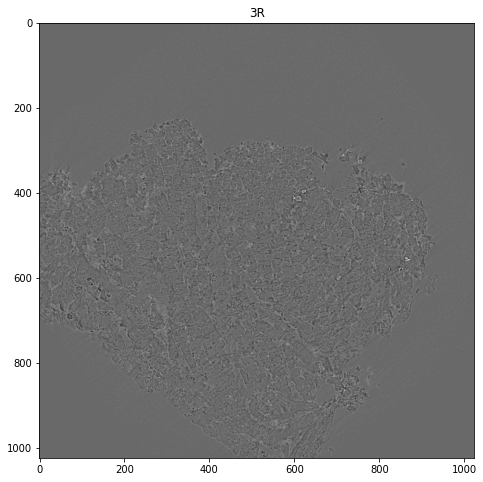

In [3]:
# Get an item at a specific index
index = 0
print(f"Train dataset item at index {index}:\n{train_dataset[index]}")
print("The pixel values are really close to 0 because the image is mostly grey (pixel_value = 0.5)")
print("Normalize(0.5, 0.5): (0.5 - 0-5) / 0.5 = 0")
print()

# Display image and label
train_features, train_labels, img_paths = next(iter(dataloaders['train']))
print(f"Feature batch shape: {train_features.size()}")
print('First image from the first batch of train dataloader:')
print(img_paths[0])
img = train_dataset[index][0].squeeze()
label = train_labels[0].item()
label = transform_label(label)
plt.figure(figsize=(8, 8))
plt.imshow(img, cmap="gray")
plt.title(label)
plt.show()

In [70]:
class ResNetNeuralNetwork(nn.Module):    
    def __init__(self, num_classes=1):  # num_classes is set to 1 for regression
        super(ResNetNeuralNetwork, self).__init__()

        # Load the pretrained ResNet model
        self.base_model = models.resnet18(weights='DEFAULT')
        # Modify the first convolutional layer to accept 1 channel (greyscale input)
        self.base_model.conv1 = nn.Conv2d(1, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=True)
        #self.base_model.conv1 = nn.Conv2d(1, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=True)

        # Replace the fully connected layer with a custom regressor
        num_ftrs = self.base_model.fc.in_features  # Typically 512 for ResNet18
        self.base_model.fc = nn.Identity()  # zasto identity, opet brisem fully connceted layer

        # Add a custom regressor (single neuron for regression)
        #self.regressor = nn.Linear(num_ftrs, num_classes)
        
        self.num_classes = num_classes
        self.head = nn.Linear(num_ftrs, num_classes) # custom regressor or classifier depending on num_classes

    def forward(self, x):
        x = self.base_model(x)
        output = self.head(x)
        if self.num_classes == 1:
            output = torch.sigmoid(output)  # Apply sigmoid function for regression
            output = 4 * output - 0.5  # Scale predictions to the range (-0.5, 3.5)
        else:
            output = torch.softmax(output, dim=1)
        return output

In [4]:
class DenseNetNeuralNetwork(nn.Module):
    def __init__(self, num_classes=1):  # num_classes is set to 1 for regression
        super(DenseNetNeuralNetwork, self).__init__()

        # Load the pretrained DenseNet model
        self.base_model = models.densenet121(weights='DEFAULT')

        # Modify the first convolutional layer to accept 1 channel (greyscale input)
        self.base_model.features[0] = nn.Conv2d(1, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=True)

        # Remove the fully connected layer
        self.base_model = nn.Sequential(*list(self.base_model.children())[:-1])

        # Add a custom head (linear layer)
        self.num_classes = num_classes
        self.head = nn.Linear(1024, num_classes)  # Adjust the input size based on the DenseNet variant used

    def forward(self, x):
        x = self.base_model(x)
        x = x.mean([2, 3])  # Global average pooling

        output = self.head(x)

        if self.num_classes == 1:
            output = torch.sigmoid(output)  # Apply sigmoid function for regression
            output = 4 * output - 0.5  # Scale predictions to the range (-0.5, 3.5)
        else:
            output = torch.softmax(output, dim=1)  # Apply softmax function for classification

        return output

In [262]:
def make_path(model, lr, filename):
    if model.num_classes == 1:
        algorithm = 'regression'
    else:
        algorithm = 'classification'
    if isinstance(model, DenseNetNeuralNetwork):
        directory = f"densenet_models/{algorithm}/lr={lr}/"
    elif isinstance(model, ResNetNeuralNetwork):
        directory = f"resnet_models/{algorithm}/lr={lr}/"
    os.makedirs(directory, exist_ok=True)
    return directory + filename

def save_checkpoint(state, lr, model):
    print("=> Saving checkpoint")
    path = make_path(model, lr, "checkpoint.pth")           
    torch.save(state, path)
"""    
def load_checkpoint(checkpoint):
    print("=> Loading checkpoint")
    print(f"Loss: {checkpoint['loss']}")
    print(f"Accuracy: {checkpoint['accuracy']}%")
    model.load_state_dict(checkpoint['model_state'])
    optimizer.load_state_dict(checkpoint['optimizer'])
    return checkpoint['loss'], checkpoint['accuracy'], checkpoint['actual_labels'], checkpoint['predicted_labels']
"""

def load_checkpoint(checkpoint, model, optimizer):
    print("=> Loading checkpoint")
    print(f"Loss: {checkpoint['loss']}")
    print(f"Accuracy: {checkpoint['accuracy']}%")
    model.load_state_dict(checkpoint['model_state'])
    optimizer.load_state_dict(checkpoint['optimizer'])
    return model, optimizer

# za ucitavanje unfiltered_trainset_lr=5e-06.pth
# jer sam tamo spremio druge parametre u checkpoint
def load_checkpoint_old(checkpoint):
    print("=> Loading checkpoint")
    print(f"Epoch: {checkpoint['epoch']}")
    print(f"Loss: {checkpoint['loss']}")
    print(f"Accuracy: {checkpoint['accuracy']}%")
    model.load_state_dict(checkpoint['model_state'])
    optimizer.load_state_dict(checkpoint['optimizer'])
    return checkpoint['epoch'], checkpoint['loss'], checkpoint['accuracy']

def round_outputs(outputs):
    return torch.round(outputs)

def correct_predictions(predictions, targets):
    return (predictions==targets).sum().item()

def save_confusion_matrix(actual, predicted, path):
    conf_matrix = confusion_matrix(actual.cpu(), predicted.cpu())

    labels = ['0R', '1R', '2R', '3R']
    sns.heatmap(conf_matrix, annot=True, fmt='d', cmap='Blues', xticklabels=labels, yticklabels=labels)
    plt.xlabel('Predviđeno')
    plt.ylabel('Stvarno')
    plt.savefig(path)
    plt.show()
    plt.close()

In [83]:
device = (
    "cuda:1"
    if torch.cuda.is_available()
    else "mps"
    if torch.backends.mps.is_available()
    else "cpu"
)
print(f"Using {device} device")

print(f"Is CUDA supported by this system? {torch.cuda.is_available()}")
print(f"CUDA version: {torch.version.cuda}")

Using cuda:1 device
Is CUDA supported by this system? True
CUDA version: 11.8


In [84]:
num_classes = 4
model = ResNetNeuralNetwork(num_classes)
model.to(device)

if num_classes == 1:
    criterion = nn.MSELoss(reduction='sum')
else:
    criterion = nn.CrossEntropyLoss(reduction='sum')
# Optimizer
lr = 1e-05
optimizer = optim.Adam(model.parameters(), lr=lr)

In [85]:
num_epochs = 15 # 10 do 15
train_losses, val_losses = [], []
train_accuracies, val_accuracies = [], []
actual_labels, predicted_labels = [], []

max_val_accuracy = 0.0
load_model = False
if load_model:
    _, max_val_accuracy, _, _ = load_checkpoint(torch.load("resnet_models/classification/checkpoint_lr=1e-05.pth"))

for epoch in range(num_epochs):
    # Training phase
    model.train()
    running_loss = 0.0
    train_correct = 0.0
    
    for images, labels, _ in tqdm(dataloaders['train'], desc='Training loop'):
        if model.num_classes == 1:
            labels = labels.float() # because of MSE
        else:
            labels = labels.long()
        # Move inputs and labels to the device
        images, labels = images.to(device), labels.to(device)
        
        optimizer.zero_grad() # Clear the gradients from previous iterations
        outputs = model(images) # Forward pass to obtain model predictions (equivalent to model.forward(images))
        if model.num_classes == 1:
            outputs = outputs.squeeze()
        loss = criterion(outputs, labels) # Calculate the loss 
        loss.backward() # Backward pass to compute gradients
        optimizer.step() # Update model parameters using the optimizer
        # loss.item() gives me the mean of losses in batch, for example 0.10
        running_loss += loss.item() # i don't need to scale because i used reduction='sum'
        # running_loss += loss.item() * labels.size(0) # Accumulate the running loss, scaled by the number of samples in the batch
        if model.num_classes > 1:
            outputs = torch.argmax(outputs, dim=1)
        predictions_rounded = round_outputs(outputs) # round the outputs to be 0, 1, 2 or 3
        train_correct += correct_predictions(predictions_rounded, labels)
        
    train_loss = running_loss / len(dataloaders['train'].dataset)
    train_accuracy = train_correct / len(dataloaders['train'].dataset) * 100
    
    train_losses.append(train_loss)
    train_accuracies.append(train_accuracy)
    
    # Validation phase
    model.eval()
    running_loss = 0.0
    val_correct = 0.0
    current_epoch_predicted_labels = []
    with torch.no_grad(): # No need to track gradients during validation
        for images, labels, _ in tqdm(dataloaders['val'], desc='Validation loop'):
            if model.num_classes == 1:
                labels = labels.float() # because of MSE
            else:
                labels = labels.long()
            # Move inputs and labels to the device
            images, labels = images.to(device), labels.to(device)
            
            outputs = model(images) # Forward pass to obtain model predictions (equivalent to model.forward(images))
            if model.num_classes == 1:
                outputs = outputs.squeeze()
            loss = criterion(outputs, labels)
            running_loss += loss.item() # i don't need to scale because i used reduction='sum'
            # running_loss += loss.item() * labels.size(0)
            if model.num_classes > 1:
                outputs = torch.argmax(outputs, dim=1)
            predictions_rounded = round_outputs(outputs)
            val_correct += correct_predictions(predictions_rounded, labels)
            # add this so i can use it in confusion matrix
            current_epoch_predicted_labels.append(predictions_rounded)
            if (epoch == 0):
                actual_labels.append(labels)
            
    val_loss = running_loss / len(dataloaders['val'].dataset)
    val_accuracy = val_correct / len(dataloaders['val'].dataset) * 100
     
    val_losses.append(val_loss)
    val_accuracies.append(val_accuracy)
    print(f"Epoch {epoch+1}/{num_epochs}:\n"
          f"Train loss: {train_loss}, Train accuracy: {train_accuracy:.4f}%\n"
          f"Validation loss: {val_loss}, Validation accuracy: {val_accuracy:.4f}%")
    
    # use in confusion matrix for each epoch
    current_epoch_predicted_labels = torch.cat(current_epoch_predicted_labels)
    predicted_labels.append(current_epoch_predicted_labels)
    if (epoch == 0):
        actual_labels = torch.cat(actual_labels)

    # saving model for best epoch
    if (val_accuracy > max_val_accuracy):
        checkpoint = {"loss": val_loss,
                      "accuracy": val_accuracy,
                      "actual_labels": actual_labels,
                      "predicted_labels": current_epoch_predicted_labels,
                      "model_state": model.state_dict(), 
                      "optimizer": optimizer.state_dict()}
        save_checkpoint(checkpoint, lr, model)
        max_val_accuracy = val_accuracy

Training loop:   0%|          | 0/4594 [00:00<?, ?it/s]

Validation loop:   0%|          | 0/2160 [00:00<?, ?it/s]

Epoch 1/15:
Train loss: 0.8455678296064517, Train accuracy: 93.2455%
Validation loss: 1.1595894428866882, Validation accuracy: 58.2755%
=> Saving checkpoint


Training loop:   0%|          | 0/4594 [00:00<?, ?it/s]

Validation loop:   0%|          | 0/2160 [00:00<?, ?it/s]

Epoch 2/15:
Train loss: 0.7693209610889559, Train accuracy: 98.6720%
Validation loss: 1.127399843406898, Validation accuracy: 60.8449%
=> Saving checkpoint


Training loop:   0%|          | 0/4594 [00:00<?, ?it/s]

Validation loop:   0%|          | 0/2160 [00:00<?, ?it/s]

Epoch 3/15:
Train loss: 0.7567872681615401, Train accuracy: 99.2870%
Validation loss: 1.1826683339421395, Validation accuracy: 55.9491%


Training loop:   0%|          | 0/4594 [00:00<?, ?it/s]

Validation loop:   0%|          | 0/2160 [00:00<?, ?it/s]

Epoch 4/15:
Train loss: 0.7506827202598758, Train accuracy: 99.6462%
Validation loss: 1.0886571091358308, Validation accuracy: 61.4120%
=> Saving checkpoint


Training loop:   0%|          | 0/4594 [00:00<?, ?it/s]

Validation loop:   0%|          | 0/2160 [00:00<?, ?it/s]

Epoch 5/15:
Train loss: 0.749795604620269, Train accuracy: 99.6952%
Validation loss: 1.171854491393875, Validation accuracy: 55.3704%


Training loop:   0%|          | 0/4594 [00:00<?, ?it/s]

Validation loop:   0%|          | 0/2160 [00:00<?, ?it/s]

Epoch 6/15:
Train loss: 0.7490072089262055, Train accuracy: 99.7224%
Validation loss: 1.1829496343102721, Validation accuracy: 52.2917%


Training loop:   0%|          | 0/4594 [00:00<?, ?it/s]

Validation loop:   0%|          | 0/2160 [00:00<?, ?it/s]

Epoch 7/15:
Train loss: 0.7470068416669166, Train accuracy: 99.8204%
Validation loss: 1.0516488140103994, Validation accuracy: 68.2292%
=> Saving checkpoint


Training loop:   0%|          | 0/4594 [00:00<?, ?it/s]

Validation loop:   0%|          | 0/2160 [00:00<?, ?it/s]

Epoch 8/15:
Train loss: 0.7465761124565431, Train accuracy: 99.8476%
Validation loss: 1.13286134959371, Validation accuracy: 60.6019%


Training loop:   0%|          | 0/4594 [00:00<?, ?it/s]

Validation loop:   0%|          | 0/2160 [00:00<?, ?it/s]

Epoch 9/15:
Train loss: 0.7462335085723498, Train accuracy: 99.8585%
Validation loss: 1.1415015401663604, Validation accuracy: 55.4514%


Training loop:   0%|          | 0/4594 [00:00<?, ?it/s]

Validation loop:   0%|          | 0/2160 [00:00<?, ?it/s]

Epoch 10/15:
Train loss: 0.7458834118590814, Train accuracy: 99.8585%
Validation loss: 1.1859231718436436, Validation accuracy: 50.6481%


Training loop:   0%|          | 0/4594 [00:00<?, ?it/s]

Validation loop:   0%|          | 0/2160 [00:00<?, ?it/s]

Epoch 11/15:
Train loss: 0.7457707701267638, Train accuracy: 99.8803%
Validation loss: 1.1114017047263958, Validation accuracy: 61.4815%


Training loop:   0%|          | 0/4594 [00:00<?, ?it/s]

Validation loop:   0%|          | 0/2160 [00:00<?, ?it/s]

Epoch 12/15:
Train loss: 0.7454751265014593, Train accuracy: 99.8966%
Validation loss: 1.1538780604523642, Validation accuracy: 54.3981%


Training loop:   0%|          | 0/4594 [00:00<?, ?it/s]

Validation loop:   0%|          | 0/2160 [00:00<?, ?it/s]

Epoch 13/15:
Train loss: 0.7449262734561962, Train accuracy: 99.9456%
Validation loss: 1.117647595676007, Validation accuracy: 62.7778%


Training loop:   0%|          | 0/4594 [00:00<?, ?it/s]

Validation loop:   0%|          | 0/2160 [00:00<?, ?it/s]

Epoch 14/15:
Train loss: 0.7453836026821334, Train accuracy: 99.8966%
Validation loss: 1.234906383962543, Validation accuracy: 49.5718%


Training loop:   0%|          | 0/4594 [00:00<?, ?it/s]

Validation loop:   0%|          | 0/2160 [00:00<?, ?it/s]

Epoch 15/15:
Train loss: 0.7449935972836569, Train accuracy: 99.9292%
Validation loss: 1.1784261173120252, Validation accuracy: 56.0301%


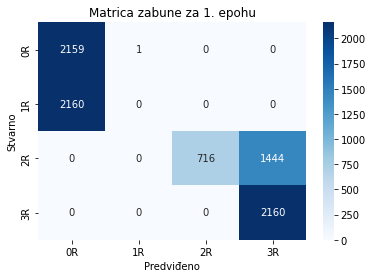

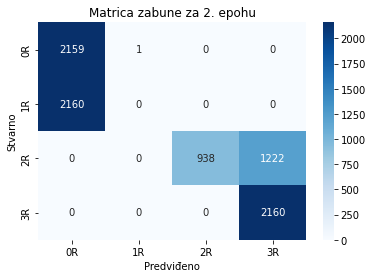

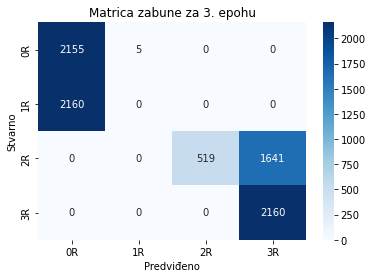

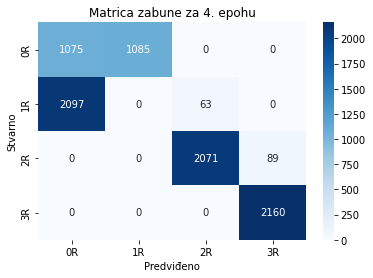

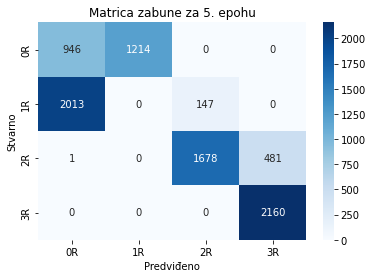

...

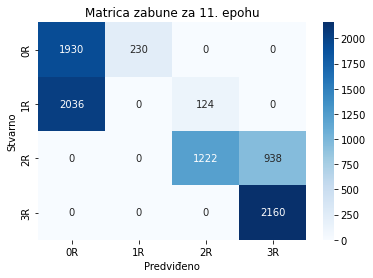

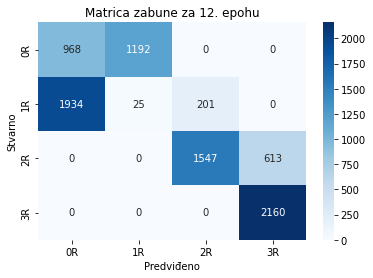

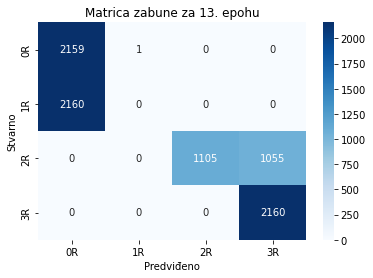

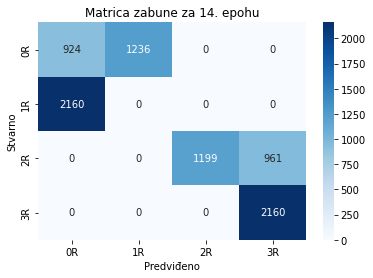

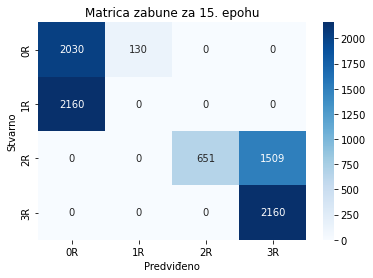

In [86]:
# actual_labels je ista za svaku epohu kod validacije
for index in range(num_epochs):
    # Create confusion matrix
    conf_matrix = confusion_matrix(actual_labels.cpu(), predicted_labels[index].cpu())

    # Plot the confusion matrix
    labels = ['0R', '1R', '2R', '3R']
    sns.heatmap(conf_matrix, annot=True, fmt='d', cmap='Blues', xticklabels=labels, yticklabels=labels)
    plt.xlabel('Predviđeno')
    plt.ylabel('Stvarno')
    plt.title(f'Matrica zabune za {index + 1}. epohu')
    plt.show()

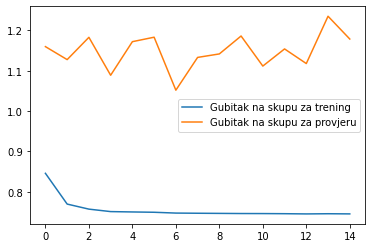

In [87]:
plt.plot(train_losses, label='Gubitak na skupu za trening')
plt.plot(val_losses, label='Gubitak na skupu za provjeru')
plt.legend()
#plt.title("Gubitak po epohama")
path = make_path(model, lr, "gubitak.png")
plt.savefig(path)
plt.show()
plt.close()

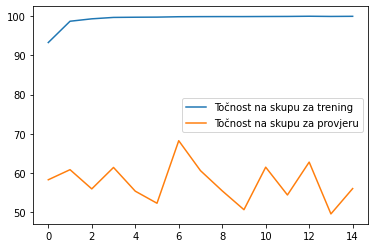

In [88]:
plt.plot(train_accuracies, label='Točnost na skupu za trening')
plt.plot(val_accuracies, label='Točnost na skupu za provjeru')
plt.legend()
#plt.title("Accuracy over epochs")
path = make_path(model, lr, "tocnost.png")
plt.savefig(path)
plt.show()
plt.close()

In [24]:
# Check the total number of images in the test dataset
total_test_images = len(test_dataset)
print(f"Total number of test images: {total_test_images}")

# Check the distribution of labels
labels = [label for _, label, _ in test_dataset]
label_counts = Counter(labels)

sorted_label_counts = sorted(label_counts.items(), key=lambda x: x[0])
  
for label, count in sorted_label_counts:
    print(f"Label {transform_label(label)}: {count} samples")

Total number of test images: 21999
Label 0R: 4221 samples
Label 1R: 4721 samples
Label 2R: 4919 samples
Label 3R: 8138 samples


Test dataset item at index 0:
(tensor([[[0.0118, 0.0118, 0.0118,  ..., 0.0118, 0.0118, 0.0118],
         [0.0118, 0.0118, 0.0118,  ..., 0.0118, 0.0118, 0.0118],
         [0.0118, 0.0118, 0.0118,  ..., 0.0118, 0.0118, 0.0118],
         ...,
         [0.0118, 0.0118, 0.0118,  ..., 0.0118, 0.0118, 0.0118],
         [0.0118, 0.0118, 0.0118,  ..., 0.0118, 0.0118, 0.0118],
         [0.0118, 0.0118, 0.0118,  ..., 0.0118, 0.0118, 0.0118]]]), 0.0, '/home/code/dataset_test/026_101_17_HA_0R/026_101_17_HA_S2_/026_101_17_HA_S2_0429.rec.8bit.tif')
The pixel values are really close to 0 because the image is mostly grey (pixel_value = 0.5)
Normalize(0.5, 0.5): (0.5 - 0-5) / 0.5 = 0

Feature batch shape: torch.Size([4, 1, 1024, 1024])
First image from the first batch of train dataloader:
/home/code/dataset_test/026_101_17_HA_0R/026_101_17_HA_S2_/026_101_17_HA_S2_0429.rec.8bit.tif


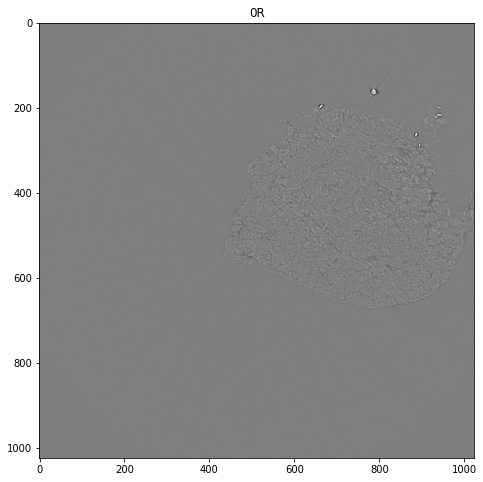

In [14]:
# Get an item at a specific index
index = 0
print(f"Test dataset item at index {index}:\n{test_dataset[index]}")
print("The pixel values are really close to 0 because the image is mostly grey (pixel_value = 0.5)")
print("Normalize(0.5, 0.5): (0.5 - 0-5) / 0.5 = 0")
print()

# Display image and label
test_features, test_labels, img_paths = next(iter(dataloaders['test']))
print(f"Feature batch shape: {test_features.size()}")
print('First image from the first batch of train dataloader:')
print(img_paths[0])
img = test_dataset[index][0].squeeze()
label = test_labels[0].item()
label = transform_label(label)
plt.figure(figsize=(8, 8))
plt.imshow(img, cmap="gray")
plt.title(label)
plt.show()

In [90]:
num_classes = 4
model = ResNetNeuralNetwork(num_classes)
model.to(device)
lr = 1e-05
optimizer = optim.Adam(model.parameters(), lr=lr)
if num_classes == 1:
    criterion = nn.MSELoss(reduction='sum')
    algorithm = "regression"
else:
    criterion = nn.CrossEntropyLoss(reduction='sum')
    algorithm = "classification"
    
if isinstance(model, DenseNetNeuralNetwork):
    architecture = "densenet_models"
elif isinstance(model, ResNetNeuralNetwork):
    architecture = "resnet_models"
    
_, _, actual, predicted = load_checkpoint(torch.load(f"{architecture}/{algorithm}/lr={lr}/checkpoint.pth"))

=> Loading checkpoint
Loss: 1.0516488140103994
Accuracy: 68.22916666666666%


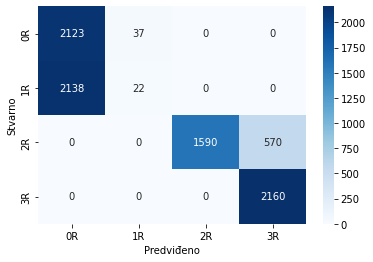

In [91]:
path = make_path(model, lr, "matrica_zabune_provjera.png")
save_confusion_matrix(actual, predicted, path)

Using cuda:1 device
Is CUDA supported by this system? True
CUDA version: 11.8


Test loop:   0%|          | 0/5500 [00:00<?, ?it/s]

Test loss: 1.340317932647642, Test accuracy: 39.8064%



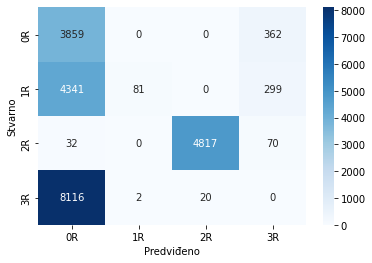

In [89]:
# bez csva
device = (
    "cuda:1"
    if torch.cuda.is_available()
    else "mps"
    if torch.backends.mps.is_available()
    else "cpu"
)
print(f"Using {device} device")

print(f"Is CUDA supported by this system? {torch.cuda.is_available()}")
print(f"CUDA version: {torch.version.cuda}")

model.eval()
running_loss = 0.0
test_correct = 0.0
actual_labels, predicted_labels = [], []
with torch.no_grad(): # No need to track gradients during testing
    for images, labels, img_paths in tqdm(dataloaders['test'], desc='Test loop'):
        if model.num_classes == 1:
            labels = labels.float() # because of MSE
        else:
            labels = labels.long()
        # Move inputs and labels to the device
        images, labels = images.to(device), labels.to(device)

        outputs = model(images) # Forward pass to obtain model predictions (equivalent to model.forward(images))
        if model.num_classes == 1:
            outputs = outputs.squeeze()
        loss = criterion(outputs, labels)
        running_loss += loss.item() # i don't need to scale because i used reduction='sum'
        # running_loss += loss.item() * labels.size(0)
        if model.num_classes > 1:
            outputs = torch.argmax(outputs, dim=1)
        predictions_rounded = round_outputs(outputs)
        test_correct += correct_predictions(predictions_rounded, labels)
        # add this so i can use it in confusion matrix
        predicted_labels.append(predictions_rounded)
        actual_labels.append(labels)

test_loss = running_loss / len(dataloaders['test'].dataset)
test_accuracy = test_correct / len(dataloaders['test'].dataset) * 100

print(f"Test loss: {test_loss}, Test accuracy: {test_accuracy:.4f}%\n")

predicted_labels = torch.cat(predicted_labels)
actual_labels = torch.cat(actual_labels)

path = make_path(model, lr, "matrica_zabune_test.png")
save_confusion_matrix(actual_labels, predicted_labels, path)

Test loop:   0%|          | 0/5500 [00:00<?, ?it/s]

CSV file saved at predictions.csv
Test loss: 3.870757186360892, Test accuracy: 35.1016%



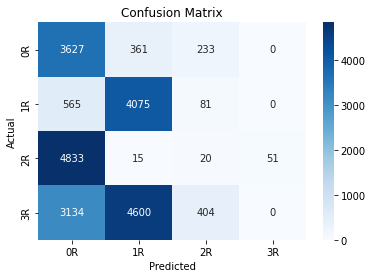

In [167]:
# sa csvom
model.eval()
running_loss = 0.0
test_correct = 0.0
actual_labels, predicted_labels = [], []
csv_data = []
with torch.no_grad(): # No need to track gradients during testing
    for images, labels, img_paths in tqdm(dataloaders['test'], desc='Test loop'):
        labels = labels.float() # because of MSE
        # Move inputs and labels to the device
        images, labels = images.to(device), labels.to(device)

        outputs = model(images)
        loss = criterion(outputs, labels)
        running_loss += loss.item() # i don't need to scale because i used reduction='sum'
        # running_loss += loss.item() * labels.size(0)
        predictions_rounded = round_outputs(outputs)
        test_correct += correct_predictions(predictions_rounded, labels)
        # add this so i can use it in confusion matrix
        predicted_labels.append(predictions_rounded)
        actual_labels.append(labels)
        
        for i in range(len(img_paths)):
            # Check if the real label is '2R' or '3R'
            labels[i].item()
            if (labels[i].item() == 2) or (labels[i].item() == 3):
                data_entry = {
                    'img_path': img_paths[i],
                    'prediction': outputs[i].item()
                }
                csv_data.append(data_entry)
                

# Define the CSV file path
csv_file_path = 'predictions.csv'

# Write the data to the CSV file
with open(csv_file_path, mode='w', newline='') as file:
    fieldnames = ['img_path','prediction']
    writer = csv.DictWriter(file, fieldnames=fieldnames)

    # Write header
    writer.writeheader()

    # Write data
    for data_entry in csv_data:
        writer.writerow(data_entry)

print(f"CSV file saved at {csv_file_path}")


test_loss = running_loss / len(dataloaders['test'].dataset)
test_accuracy = test_correct / len(dataloaders['test'].dataset) * 100

print(f"Test loss: {test_loss}, Test accuracy: {test_accuracy:.4f}%\n")

predicted_labels = torch.cat(predicted_labels)
actual_labels = torch.cat(actual_labels)

path = make_path(model, lr, "matrica_zabune_test.png")
save_confusion_matrix(actual_labels, predicted_labels, path)

In [159]:
# Define the CSV file path
csv_file_path = 'predictions.csv'

# Write the data to the CSV file
with open(csv_file_path, mode='w', newline='') as file:
    fieldnames = ['img_path','prediction']
    writer = csv.DictWriter(file, fieldnames=fieldnames)

    # Write header
    writer.writeheader()

    # Write data
    for data_entry in csv_data:
        writer.writerow(data_entry)

print(f"CSV file saved at {csv_file_path}")

CSV file saved at predictions.csv


In [92]:
# Load and preprocess the image
def preprocess_image(image_path, transform):
    image = Image.open(image_path)
    return image, transform(image).unsqueeze(0)

# Predict using the model
def predict(model, image_tensor, device="cpu"):
    model.eval()
    with torch.no_grad():
        image_tensor = image_tensor.to(device)
        output = model(image_tensor)
        if model.num_classes > 1:
            output = torch.argmax(output, dim=1)
    return output

def visualize_predictions(original_image, prediction, label):
    img = original_image
    plt.figure(figsize=(16, 16))
    plt.imshow(img, cmap="gray")
    plt.title(f'Actual: {label}, Predicted: {prediction}')
    plt.show()
    
def get_label(image_path):
    for label in ["0R", "1R", "2R", "3R"]:
        if label in image_path:
            return label

In [ ]:
root_directory = '/home/datasets/dataset_biopsies_small2'
test_image_path = os.path.join(root_directory, "./2017/07_4001_3R/rec_8bit_07/07_4001_3R2159.rec.8bit.tif")
label = get_label(test_image_path)

original_image, image_tensor = preprocess_image(test_image_path, val_transforms)
prediction = predict(model, image_tensor).cpu().item()

visualize_predictions(original_image, prediction, label)

In [ ]:
biopsies_list_path = 'image_paths/train_and_val.txt'
with open(biopsies_list_path, 'r') as file:
    biopsies_list = file.readlines()
    
num_images = 10
for i in range(num_images):
    random_line = random.choice(biopsies_list)
    test_image_path = os.path.join(root_directory, random_line.strip())
    print(test_image_path)
    label = get_label(test_image_path)

    original_image, image_tensor = preprocess_image(test_image_path, val_transforms)
    prediction = predict(model, image_tensor, device).cpu().item()

    visualize_predictions(original_image, prediction, label)

In [260]:
# for gradcam
device = (
    "cuda"
    if torch.cuda.is_available()
    else "mps"
    if torch.backends.mps.is_available()
    else "cpu"
)

# dela mi samo densenet klasifikator
num_classes = 1  # ovo mijenjaj ovisno o classification i regression
t = "regression" if num_classes == 1 else "classification"
model = ResNetNeuralNetwork(num_classes)
m = "resnet_models" if isinstance(model, ResNetNeuralNetwork) else "densenet_models"
lr = 1e-05
optimizer = optim.Adam(model.parameters(), lr=lr)
# model.to(device) # ovo ne jer mi ne radi use_cuda parametar u GradCAM
load_checkpoint(torch.load(f"{m}/{t}/lr={lr}/checkpoint.pth"))

=> Loading checkpoint
Loss: 0.0981205770510348
Accuracy: 92.29166666666667%


(0.0981205770510348,
 92.29166666666667,
 tensor([0., 0., 0.,  ..., 2., 2., 2.], device='cuda:1'),
 tensor([0., 0., 0.,  ..., 2., 2., 2.], device='cuda:1'))

=> Loading checkpoint
Loss: 0.0981205770510348
Accuracy: 92.29166666666667%
=> Loading checkpoint
Loss: 1.0516488140103994
Accuracy: 68.22916666666666%
1
0.1757098
/home/datasets/dataset_biopsies_small2/./2017/06_4003_0R_B3/rec_8bit_06_B3/06_4003_0R_B31537.rec.8bit.tif
Actual: 0, Predicted: -0.1935059130191803


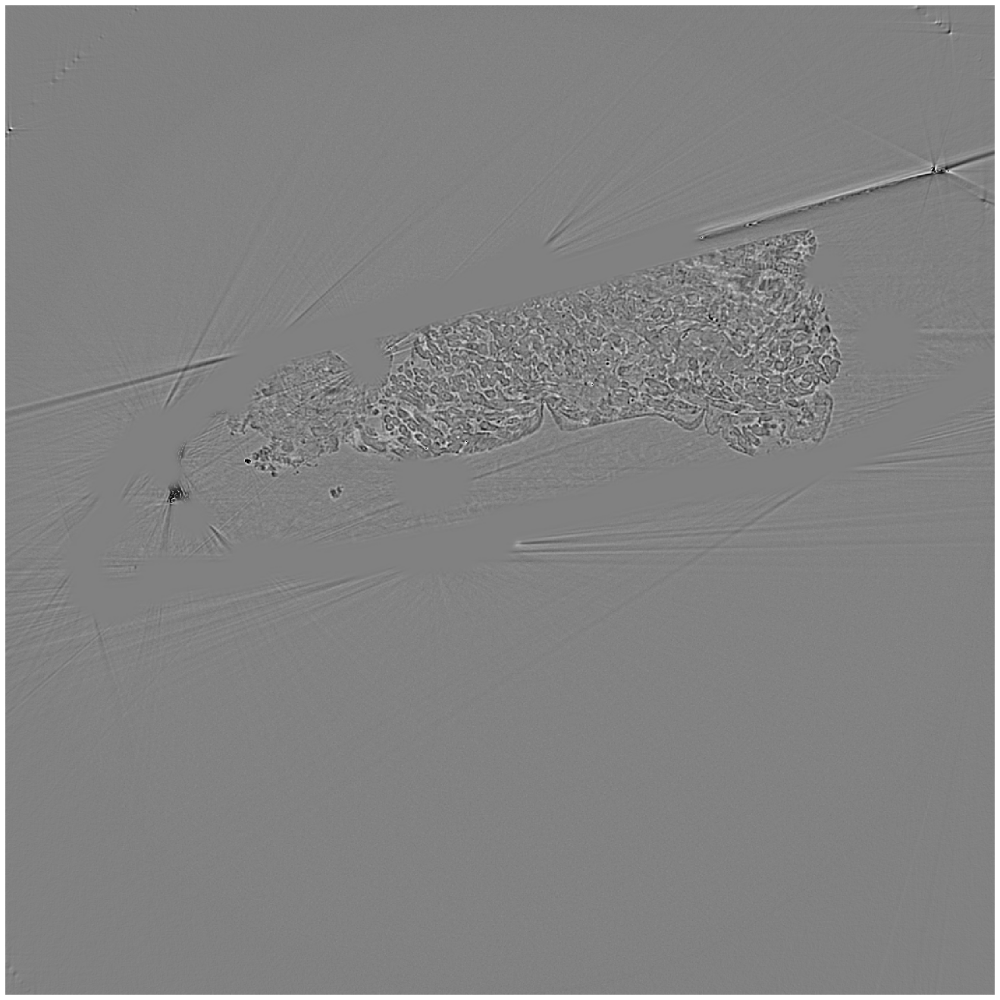

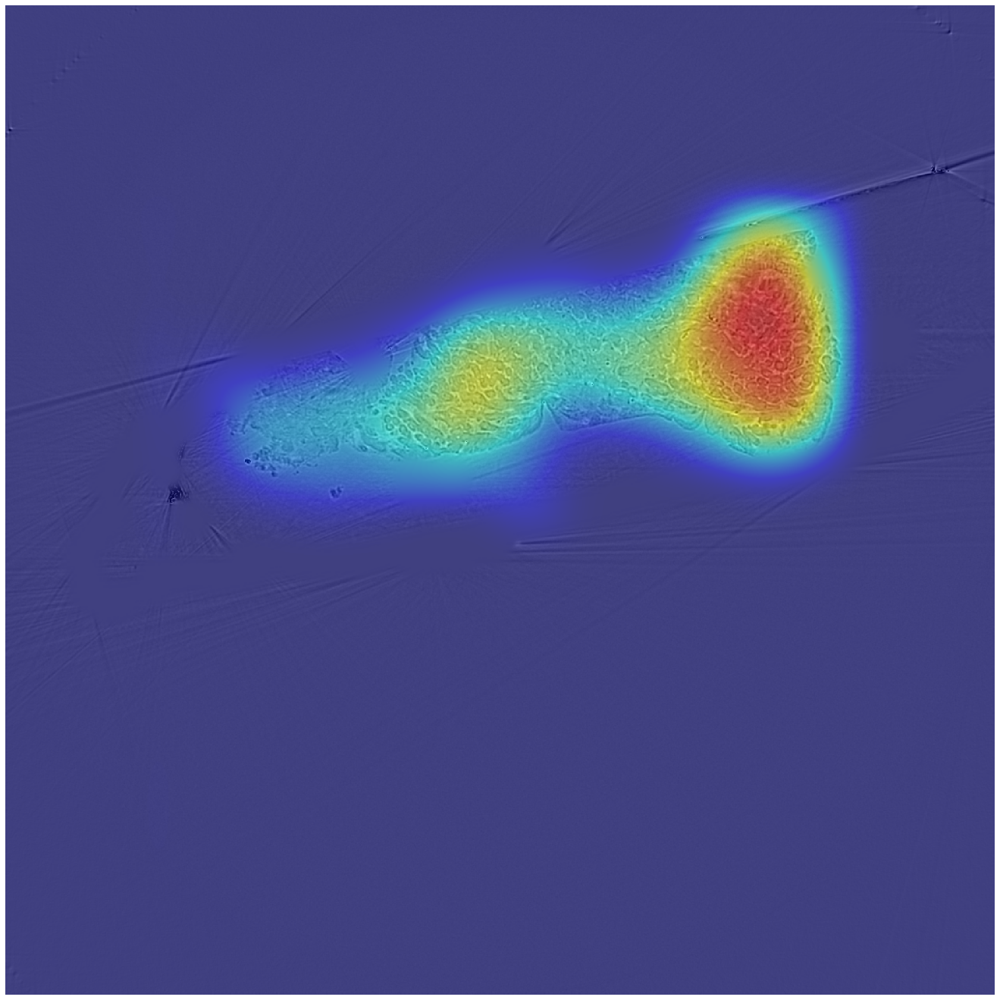

4
0.14538167
/home/datasets/dataset_biopsies_small2/./2017/06_4003_0R_B3/rec_8bit_06_B3/06_4003_0R_B31537.rec.8bit.tif
Actual: 0, Predicted: 0


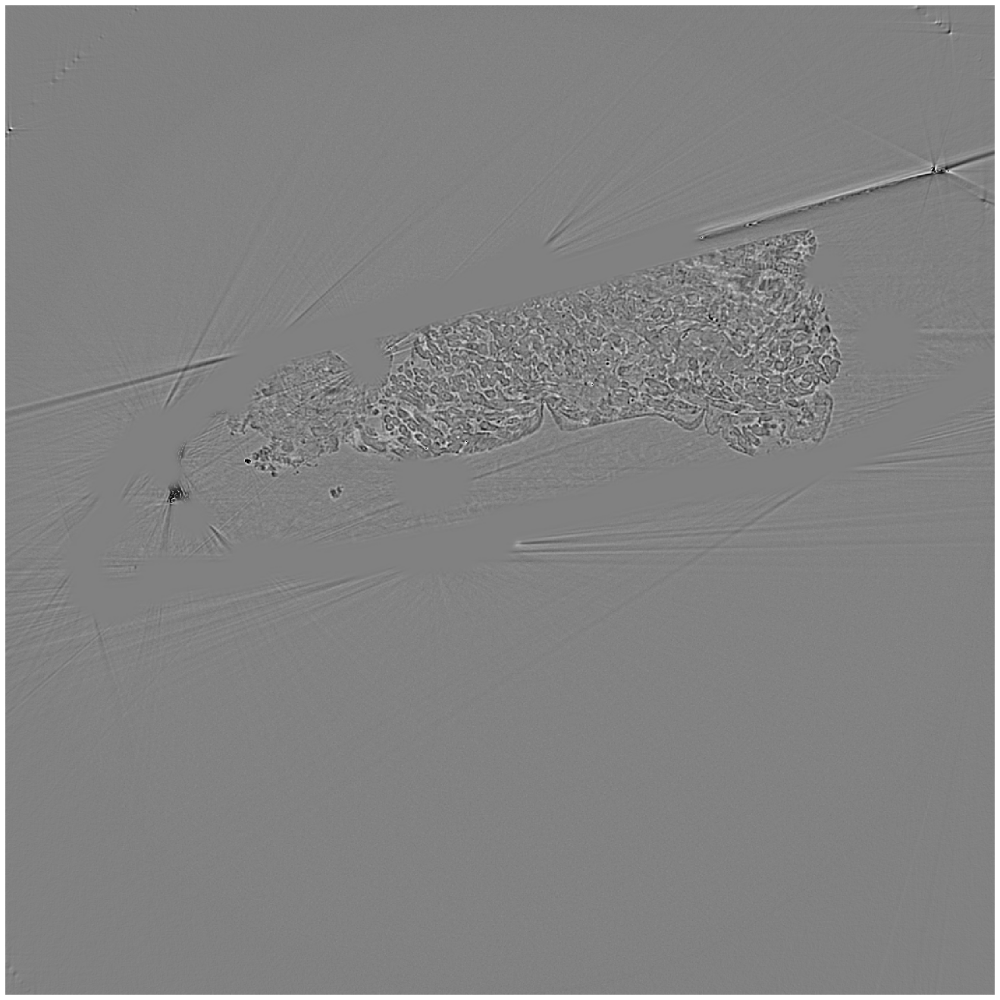

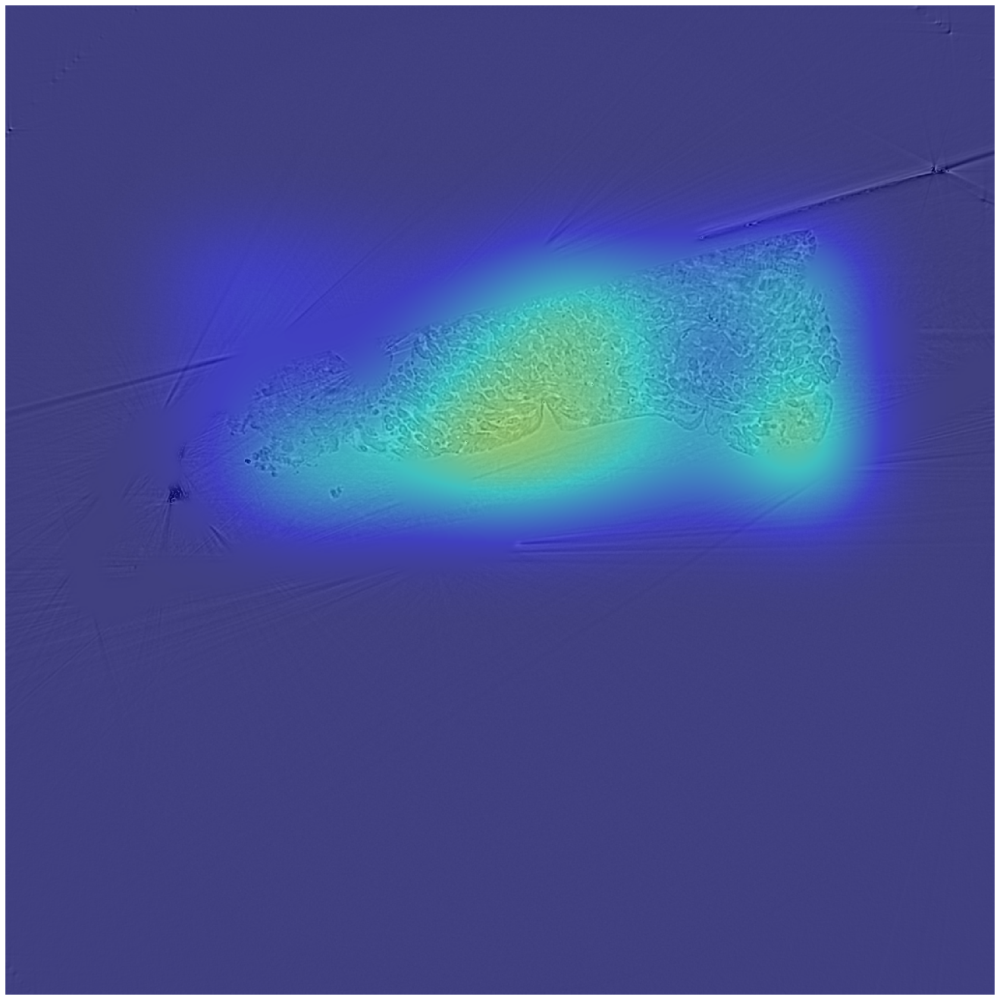

1
0.1757098
/home/datasets/dataset_biopsies_small2/./2017/08_4001_2_3R_B2/rec_8bit_08_B2/08_4001_2_3R_B20417.rec.8bit.tif
Actual: 3, Predicted: 2.9987761974334717


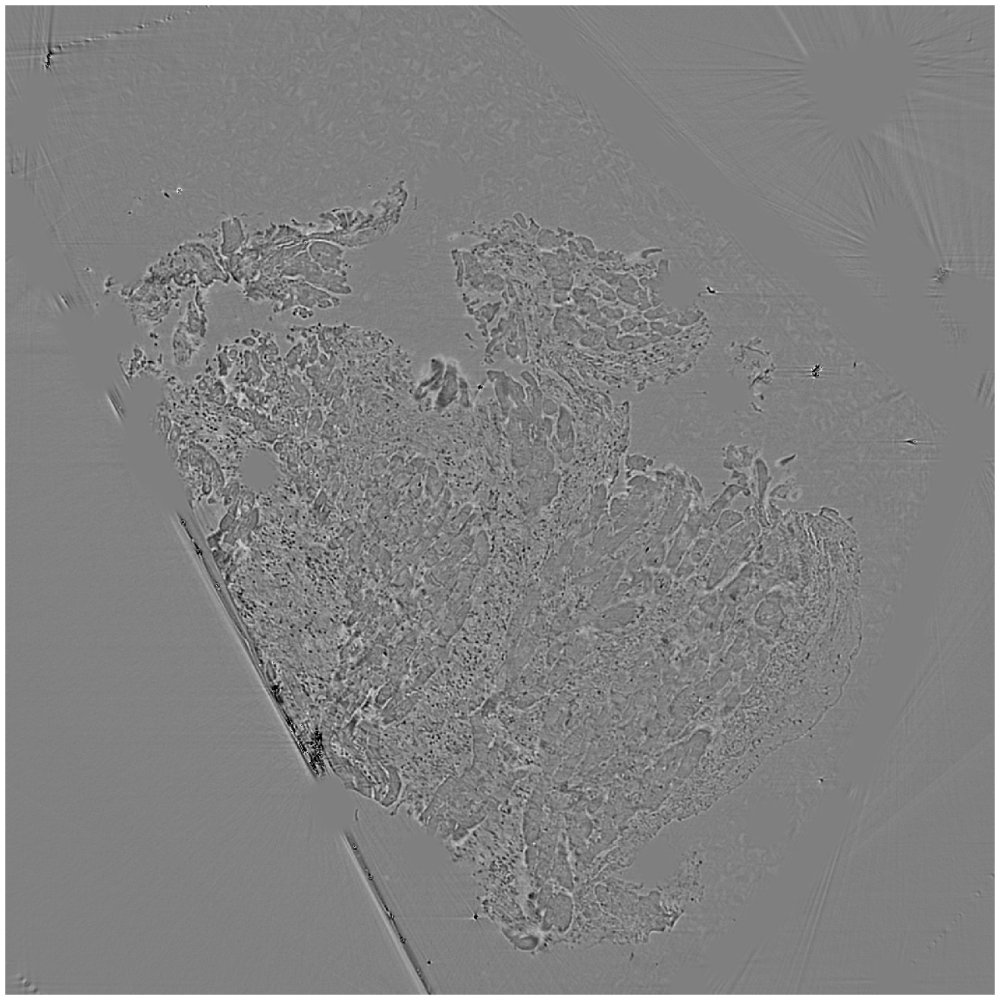

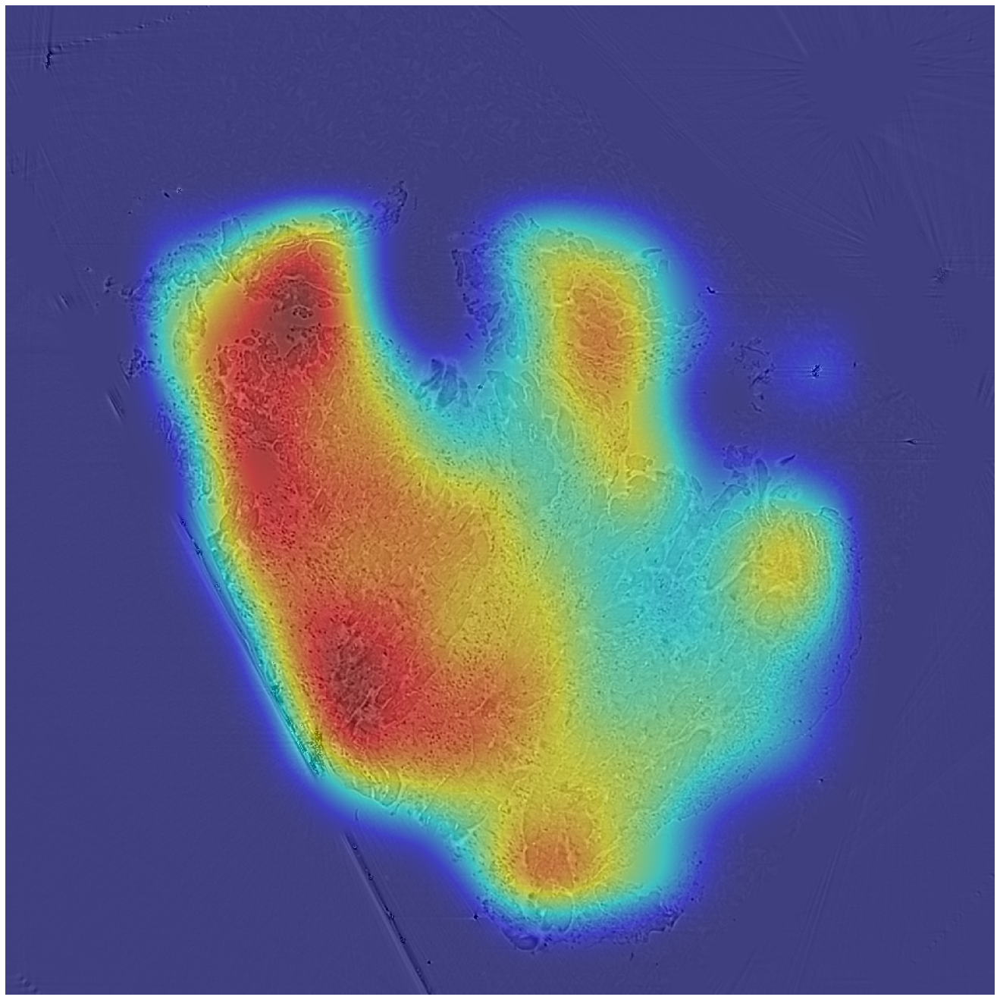

4
0.14538167
/home/datasets/dataset_biopsies_small2/./2017/08_4001_2_3R_B2/rec_8bit_08_B2/08_4001_2_3R_B20417.rec.8bit.tif
Actual: 3, Predicted: 3


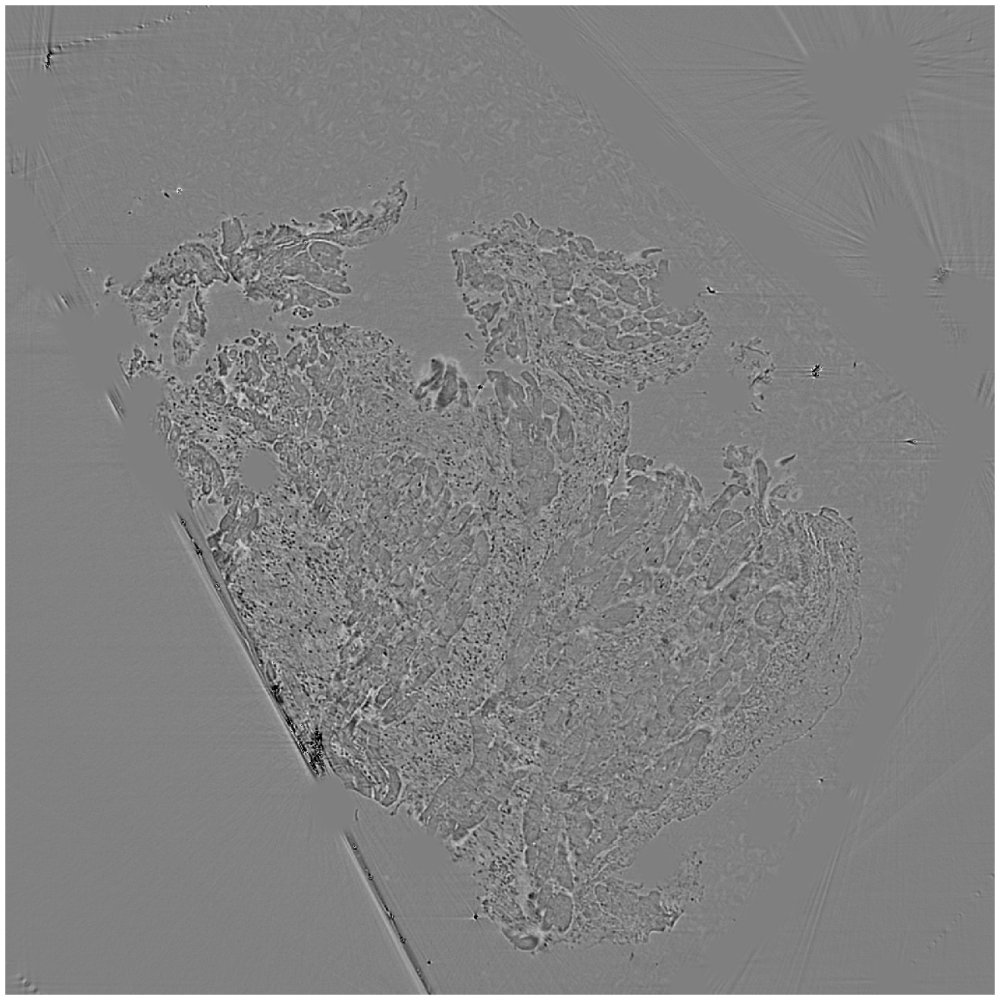

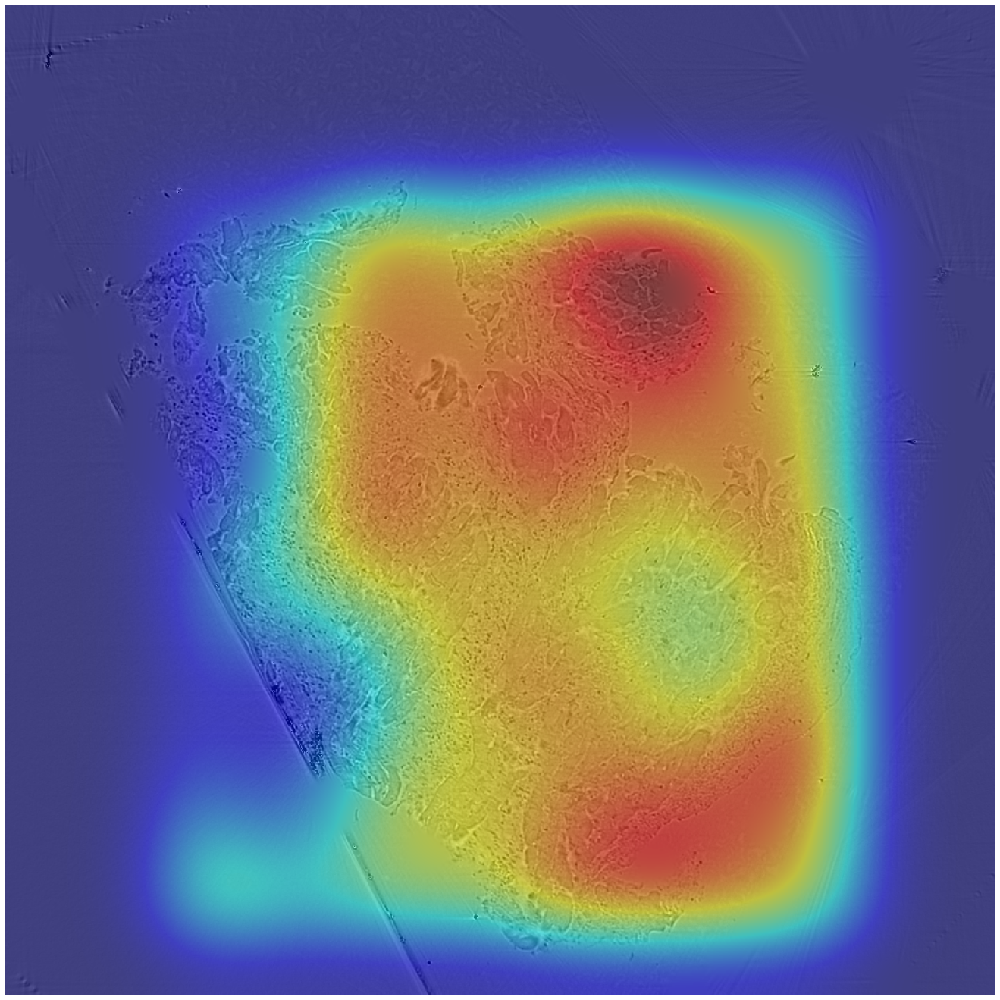

In [322]:
from pytorch_grad_cam import GradCAM
from pytorch_grad_cam.utils.model_targets import ClassifierOutputTarget
from pytorch_grad_cam.utils.image import show_cam_on_image
import cv2

def apply_edge_smoothing(grayscale_cam, fade_width=50):
    """
    Applies edge smoothing to the Grad-CAM heatmap by reducing intensity towards the borders.
    
    grayscale_cam: The original Grad-CAM heatmap.
    fade_width: The width in pixels for fading the edges.
    """
    h, w = grayscale_cam.shape
    mask = np.ones_like(grayscale_cam)

    # Apply a horizontal gradient to fade out the left and right sides
    for i in range(fade_width):
        fade_factor = i / fade_width  # Gradual fade from 0 to 1
        mask[:, i] *= fade_factor  # Fade out left side
        mask[:, w - i - 1] *= fade_factor  # Fade out right side

    return grayscale_cam * mask
 
def createGradCamExplanation(model, target_layers, img, transform, cam=None, label=None, prediction=None):
    img_pil = Image.fromarray(img)
    input_tensor = transform(img_pil).unsqueeze(0) # grayscale_cam needs a 4d input
    #print(img.shape, input_tensor.shape) # 2d and 4d
    if cam is None:
        cam = GradCAM(model=model, target_layers=target_layers)
    # You can also pass aug_smooth=True and eigen_smooth=True, to apply smoothing.
    #if model.num_classes > 1 and prediction is not None:
        # kako namjestiti targets za regresiju?
        #targets = [ClassifierOutputTarget([prediction])] # ovaj broj u zagradi mozes mjenjati pa vidis kako za koju klasu gleda
        #grayscale_cam = cam(input_tensor=input_tensor, targets=targets)
    #else:
        # jel nije da ovo automatski kao target stavlja prediction
        #grayscale_cam = cam(input_tensor=input_tensor) # grayscale_cam needs a 4d input
        
    grayscale_cam = cam(input_tensor=input_tensor) # grayscale_cam needs a 4d input

    #print(gmax)
    # In this example grayscale_cam has only one image in the batch:
    grayscale_cam = grayscale_cam.squeeze() # reduces dimensionality from (batch_size, H, W) to (H, W)
    
    if gmax == 0: # gmax is 0 when there is no activation at all
        gmax = 1e-8
    grayscale_cam = np.clip(grayscale_cam / gmax, 0, 1)
    resized_heatmap = grayscale_cam
    
    img_resized = np.array(img_pil.resize((1024, 1024)))  # resize
    img_resized = img_resized[..., np.newaxis] # add extra dimension
    img_resized[img_resized > 1] = 1 # this can happen during resizing 
    visualization = show_cam_on_image(img_resized, resized_heatmap, use_rgb=True) # if false then it uses BGR
    return visualization
 
# PRIMJER POZIVANJA, TREBA MODEL, PROMJENIT IME LAYERA, IZVADIT TRANSFORM IZ DATASETA (ili inicijalizirati isti kao u datasetu...) I LOADAT SLIKU KO NUMPY ARRAY (znaci ekvivalent iz dataseta prije transformacija)
transform =  transforms.Compose([
    #transforms.CenterCrop(512),
    transforms.Resize((1024,1024)),
    transforms.ToTensor(),
    #transforms.Normalize(0.5, 0.5)
])

root_directory = '/home/datasets/dataset_biopsies_small2'
image_paths = {}
image_paths['custom'] = [
    os.path.join(root_directory, "33_1012_1_0R/rec_8bit_33/33_1012_1_0R1783.rec.8bit.tif"),  # 0R validation
    os.path.join(root_directory, "19_1021_1_1R1a/rec_8bit_19/19_1021_1_1R1a0737.rec.8bit.tif"),  # 1R validation
    os.path.join(root_directory, "2017/12_4009_2R/rec_8bit_12/12_4009_2R0847.rec.8bit.tif"),  # 2R validation
    os.path.join(root_directory, "2017/07_4001_3R/rec_8bit_07/07_4001_3R1244.rec.8bit.tif"),  # 3R validation
    "/home/code/dataset_test/026_101_17_HA_0R/026_101_17_HA_S2_/026_101_17_HA_S2_0429.rec.8bit.tif",  # 0R test
    "/home/code/dataset_test/023_101_15_HA_1R/023_101_15_HA_S2_/023_101_15_HA_S2_1848.rec.8bit.tif",  # 1R test
    "/home/code/dataset_test/38_201-01.2_2R/38_201-01.2_S1/38_201-01.2_S1_1819.rec.8bit.tif",  # 2R test
    "/home/code/dataset_test/12_101-55.5_3R/12_101-55.5_S1/12_101-55.5_HA_S1_1006.rec.8bit.tif"  # 3R test
]
 
biopsies_list_path = 'image_paths/train_and_val.txt'
with open(biopsies_list_path, 'r') as file:
    #biopsies_list = file.readlines()
    biopsies_list = [line for line in file if '0R' in line]
    
image_paths['random_train_val'] = random.sample(biopsies_list, 20)
image_paths['random_train_val'] = [os.path.join(root_directory, line.strip()) for line in image_paths['random_train_val']]

biopsies_list_path = 'image_paths/test_image_paths.txt'
with open(biopsies_list_path, 'r') as file:
    biopsies_list = file.readlines()
image_paths['random_test'] = random.sample(biopsies_list, 10)
image_paths['random_test'] = [line.strip() for line in image_paths['random_test']]

image_paths['zavrsni'] = [
    "/home/datasets/dataset_biopsies_small2/./2017/07_4001_3R/rec_8bit_07/07_4001_3R1914.rec.8bit.tif",
    "/home/datasets/dataset_biopsies_small2/./2017/08_4001_2_3R_B2/rec_8bit_08_B2/08_4001_2_3R_B20151.rec.8bit.tif",
    "/home/datasets/dataset_biopsies_small2/./2017/07_4001_3R/rec_8bit_07/07_4001_3R0348.rec.8bit.tif",
    "/home/datasets/dataset_biopsies_small2/./2017/07_4001_3R/rec_8bit_07/07_4001_3R1765.rec.8bit.tif",
    "/home/datasets/dataset_biopsies_small2/./2017/07_4001_3R/rec_8bit_07/07_4001_3R1626.rec.8bit.tif",
    "/home/datasets/dataset_biopsies_small2/./2017/08_4001_2_3R_B2/rec_8bit_08_B2/08_4001_2_3R_B20417.rec.8bit.tif",
    "/home/datasets/dataset_biopsies_small2/./2017/06_4003_0R_B3/rec_8bit_06_B3/06_4003_0R_B31253.rec.8bit.tif",
    "/home/datasets/dataset_biopsies_small2/./34_1013_1_0R/rec_8bit_34/34_1013_1_0R0368.rec.8bit.tif",
    "/home/datasets/dataset_biopsies_small2/./34_1013_1_0R/rec_8bit_34/34_1013_1_0R0126.rec.8bit.tif",
    "/home/datasets/dataset_biopsies_small2/./34_1013_1_0R/rec_8bit_34/34_1013_1_0R0056.rec.8bit.tif"
]

image_paths['winners'] = [
    "/home/datasets/dataset_biopsies_small2/./2017/06_4003_0R_B3/rec_8bit_06_B3/06_4003_0R_B31537.rec.8bit.tif",
    "/home/datasets/dataset_biopsies_small2/./2017/08_4001_2_3R_B2/rec_8bit_08_B2/08_4001_2_3R_B20417.rec.8bit.tif"
]

device = (
    "cuda"
    if torch.cuda.is_available()
    else "mps"
    if torch.backends.mps.is_available()
    else "cpu"
)

num_classes = 1  # ovo mijenjaj ovisno o classification i regression
t = "regression" if num_classes == 1 else "classification"
model1 = ResNetNeuralNetwork(num_classes)
m = "resnet_models" if isinstance(model1, ResNetNeuralNetwork) else "densenet_models"
lr = 1e-05
optimizer1 = optim.Adam(model1.parameters(), lr=lr)
# model.to(device) # ovo ne jer mi ne radi use_cuda parametar u GradCAM
model1, optimizer1 = load_checkpoint(torch.load(f"{m}/{t}/lr={lr}/checkpoint.pth"), model1, optimizer1)

num_classes = 4  # ovo mijenjaj ovisno o classification i regression
t = "regression" if num_classes == 1 else "classification"
model2 = ResNetNeuralNetwork(num_classes)
m = "resnet_models" if isinstance(model2, ResNetNeuralNetwork) else "densenet_models"
lr = 1e-05
optimizer2 = optim.Adam(model2.parameters(), lr=lr)
# model.to(device) # ovo ne jer mi ne radi use_cuda parametar u GradCAM
model2, optimizer2 = load_checkpoint(torch.load(f"{m}/{t}/lr={lr}/checkpoint.pth"), model2, optimizer2)

for image_path in image_paths['winners']:
    img = Image.open(image_path)
    image_np = np.array(img)
    
    img = image_np
    
    # dodano
    #img = transforms.CenterCrop(512)(img)
    #img = transforms.Resize((1024,1024))(img)
    #img = np.array(img)
    # Normalize the image to range [0, 1]
    #img_normalized = img.astype(np.float32) / 255.0
    
    img_normalized = image_np.astype(np.float32) / 255.0
    original_image, image_tensor = preprocess_image(image_path, test_transforms)
    label = int(get_label(image_path)[0])
    
    for model in [model1, model2]:
        print(model.num_classes)
        prediction = predict(model, image_tensor).cpu().item()

        if isinstance(model, DenseNetNeuralNetwork):
            target_layers = [model.base_model[0].denseblock4.denselayer16.conv2]
        elif isinstance(model, ResNetNeuralNetwork):
            target_layers = [model.base_model.layer4[-1].conv2]
        else:
            target_layers = model.conv5[0]

        cam = GradCAM(model=model, target_layers=target_layers)
        visualization = createGradCamExplanation(model, target_layers=target_layers, img=img_normalized, transform=transform, cam=cam, label=label, prediction=None)

        print(image_path)
        print(f"Actual: {label}, Predicted: {prediction}")

        """
        f, axis = plt.subplots(1, 2, figsize=(24, 12))
        axis[0].imshow(img.squeeze(), cmap='gray')
        axis[1].imshow(visualization)
        plt.savefig(make_path(model, lr, f"gradcam_{label}R"), bbox_inches='tight', pad_inches=0)
        plt.show() 
        """
        
        plt.figure(figsize=(24, 24))  # Adjust the figure size based on your needs
        plt.imshow(img.squeeze(), cmap='gray')
        plt.axis('off')  # Turn off axis
        plt.savefig(make_path(model, lr, f"real_{label}R"), bbox_inches='tight', pad_inches=0)
        plt.show()

        # Save the second image with a custom figure size
        plt.figure(figsize=(24, 24))  # Adjust the figure size based on your needs
        plt.imshow(visualization)
        plt.axis('off')  # Turn off axis
        plt.savefig(make_path(model, lr, f"gradcam_{label}R"), bbox_inches='tight', pad_inches=0)
        plt.show()
        

In [ ]:
# neki korisni ispisi

In [8]:
example_out = model(images)
print(example_out.shape) # [batch_size, num_classes]
print(example_out)
example_out = example_out.squeeze() # squeeze removes dimensions with size 1 from the shape of the tensor
print(example_out.shape)
print(example_out)

torch.Size([4, 1])
tensor([[ 0.3065],
        [ 0.2740],
        [-0.0484],
        [ 0.1894]], grad_fn=<AddmmBackward0>)
torch.Size([4])
tensor([ 0.3065,  0.2740, -0.0484,  0.1894], grad_fn=<SqueezeBackward0>)


In [21]:
a_l = []
ep = 2

for e in range(ep):
    current_epoch_labels = []
    
    for _ in range(3):
        #l = torch.rand(2) * 4 - 0.5
        #current_epoch_labels.extend(round_outputs(l))
        for _, labels in dataloaders['train']:
            current_epoch_labels.append(labels)
            break
    
    current_epoch_labels = torch.cat(current_epoch_labels)
    a_l.append(current_epoch_labels)
    
for a in a_l:
    print(a)

print()
print(a_l)
print(-0.==0.) # True

tensor([0., 0., 3., 3., 0., 3., 1., 2., 0., 3., 2., 0.], dtype=torch.float64)
tensor([0., 0., 0., 2., 3., 2., 3., 2., 2., 1., 2., 0.], dtype=torch.float64)

[tensor([0., 0., 3., 3., 0., 3., 1., 2., 0., 3., 2., 0.], dtype=torch.float64), tensor([0., 0., 0., 2., 3., 2., 3., 2., 2., 1., 2., 0.], dtype=torch.float64)]
True


In [ ]:
# sam da isprobam kaj valja a kaj ne
num_classes = 4
model = ResNetNeuralNetwork(num_classes)
criterion = nn.CrossEntropyLoss()
print(isinstance(model, DenseNetNeuralNetwork))
    
# Validation phase
# DODAJ NEKE STVARI ODAVDE U PRAVI LOOP
model.eval()
running_loss = 0.0
val_correct = 0.0
current_epoch_predicted_labels = []
with torch.no_grad(): # No need to track gradients during validation
    for images, labels, _ in dataloaders['train']:
        if num_classes == 1:
            labels = labels.float() # because of MSE
        else:
            labels = labels.long()
        # Move inputs and labels to the device
        images, labels = images, labels

        outputs = model(images).squeeze() # added squeeze
        #print(outputs)
        print(labels)
        loss = criterion(outputs, labels)
        print(loss)
        running_loss += loss.item() # i don't need to scale because i used reduction='sum'
        # running_loss += loss.item() * labels.size(0)
        if model.num_classes > 1:
            outputs = torch.argmax(outputs, dim=1)
            print(outputs)
        predictions_rounded = round_outputs(outputs)
        val_correct += correct_predictions(predictions_rounded, labels)
        print(val_correct)

In [145]:
# important for normalization (not in our case)
# dataloaders['train'] is already shuffled, so 
# i can count mean and std of first 500 images
def get_mean_and_std(dataloader, num_images):
    mean = 0.
    std = 0.
    count = 0  # Counter to keep track of the number of images processed

    for images, _, _ in dataloader:
        imageCountInBatch = images.size(0) 
        images = images.view(imageCountInBatch, images.size(1), -1) # Reshaping
        mean += images.mean(2).sum(0)
        std += images.std(2).sum(0)

        count += imageCountInBatch
        if count >= num_images:
            break  # Stop iterating once the desired number of images is reached

    mean /= count
    std /= count

    return mean, std


In [86]:
get_mean_and_std(dataloaders['train'], num_images=150) # do this before transformations (except toTensor())

(tensor([0.0044]), tensor([0.0845]))

In [ ]:
import random
 
def get_random_image_as_numpy(directory, filter_info):
    images = []
    print(f"Processing directory: {directory}")
    for root, dirs, files in os.walk(directory):
        for item in files:
            item_path = os.path.join(root, item)
            if os.path.isdir(item_path): 
                continue
            elif item.endswith('.tif'):
                try:
                    image = Image.open(item_path)
                except Exception as e:
                    print(f"Failed to open image {item}: {e}")
                    continue
                if filter_info(item):
                    label = item
                    images.append(item_path)
    if not images:
        raise FileNotFoundError("No images found with the given filter.")
    random_image_path = random.choice(images)
    random_image = Image.open(random_image_path)
    return np.array(random_image), label
 
root_directory = '/home/datasets/dataset_biopsies_small2'
filter_info = lambda x: '3R' in x
 
random_image_np, label = get_random_image_as_numpy(root_directory, filter_info)
print(label)
print(random_image_np.shape)

torch.Size([1, 1, 2560, 2560])


NameError: name 'get_label' is not defined

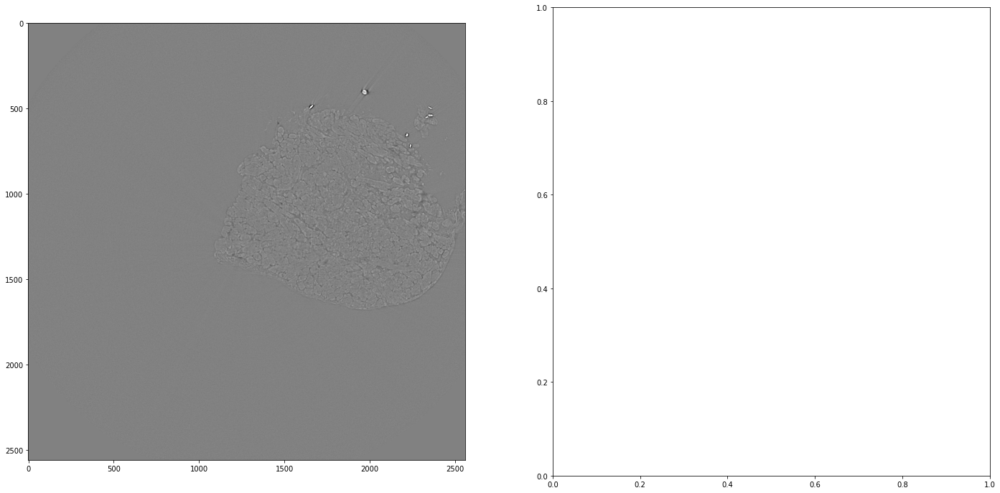

In [26]:
from pytorch_grad_cam import GradCAM
from pytorch_grad_cam.utils.model_targets import ClassifierOutputTarget
from pytorch_grad_cam.utils.image import show_cam_on_image
# from torchvision.models import resnet50

def createGradCamExplanation(model, target_layers, img, transform, cam=None):
    input_tensor = transform(img).unsqueeze(0)
    print(input_tensor.size())
    outputs = 1
    prediction = 1
    #outputs = cam.activations_and_grads(input_tensor)
    #print(outputs)
    #prediction = outputs.item()
    if cam is None:
        cam = GradCAM(model=model, target_layers=target_layers)
    
    # You can also pass aug_smooth=True and eigen_smooth=True, to apply smoothing.
    #targets = [ClassifierOutputTarget([3])] # za svaki target
    #grayscale_cam = cam(input_tensor=input_tensor, targets=targets)
    grayscale_cam = cam(input_tensor=input_tensor) # ovo je isto kao i za target=label

    # In this example grayscale_cam has only one image in the batch:
    grayscale_cam = grayscale_cam[0, :]
    # altea
    # resized_heatmap = np.array(Image.fromarray((grayscale_cam.squeeze() * 255).astype(np.uint8)).resize((img.shape[1], img.shape[0])))
    # visualization = show_cam_on_image(img[...,np.newaxis], resized_heatmap, use_rgb=True)
    visualization = show_cam_on_image(img[...,np.newaxis], grayscale_cam, use_rgb=True)
    return visualization, prediction # ovdje se jos vraco grayscale cam al ne vidim potrebu

transform = transforms.Compose([
    transforms.ToTensor(),
    #probaj bez ovog
    #transforms.Normalize(0.5, 0.5) # (pixel_val - 0.5) / 0.5
])

root_directory = '/home/datasets/dataset_biopsies_small2'
test_image_path = os.path.join(root_directory, "./2017/06_4003_0R_B2/rec_8bit_06_B2/06_4003_0R_B21782.rec.8bit.tif")#"./2017/07_4001_3R/rec_8bit_07/07_4001_3R2159.rec.8bit.tif")
test_image_path = "/home/code/dataset_test/026_101_17_HA_0R/026_101_17_HA_S2_/026_101_17_HA_S2_0429.rec.8bit.tif" # test dataset
img = Image.open(test_image_path)
#img = random_image_np
img = np.array(img).astype(np.float32) / 255.
cam = GradCAM(model=model, target_layers=target_layers) # use_cuda parameter removed
visualization, prediction = createGradCamExplanation(model, target_layers=target_layers, img=img, transform=transform, cam=cam)

f, axis = plt.subplots(1, 2, figsize=(24, 12))
axis[0].imshow(img.squeeze(), cmap='gray')
axis[0].set_title(f'Actual: {get_label(test_image_path)}')
axis[1].imshow(visualization)
axis[1].set_title(f'Predicted: {prediction}')
plt.show()

In [ ]:
c = 0
for images, labels, _ in dataloaders['train']:
    c += 1
    if c == 1:
        if model.num_classes == 1:
            labels = labels.float() # because of MSE
        else:
            labels = labels.long()
        images, labels = images.to(device), labels.to(device)
        outputs = model(images)
        print(outputs, outputs.size())
        print(labels, labels.size())
        loss = criterion(outputs, labels)
        print(loss)
    if c == 4594:
        if model.num_classes == 1:
            labels = labels.float() # because of MSE
        else:
            labels = labels.long()
        images, labels = images.to(device), labels.to(device)
        outputs = model(images)
        print(outputs, outputs.size())
        print(labels, labels.size())
        loss = criterion(outputs, labels)
        print(loss)

In [188]:
import torch
import torch.nn as nn

# Load the pre-trained model
cifar_model = torch.hub.load("chenyaofo/pytorch-cifar-models", "cifar10_shufflenetv2_x0_5", pretrained=True)

# Modify the first convolutional layer in conv1 to accept 1 input channel instead of 3
original_conv = cifar_model.conv1[0]  # Access the first Conv2d layer in conv1

# Create a new Conv2d layer with 1 input channel and the same output channels, kernel size, etc.
new_conv = nn.Conv2d(in_channels=1, 
                     out_channels=original_conv.out_channels, 
                     kernel_size=original_conv.kernel_size, 
                     stride=original_conv.stride, 
                     padding=original_conv.padding, 
                     bias=original_conv.bias)

# Copy the weights from the original layer to the new layer
with torch.no_grad():
    new_conv.weight[:, :1] = original_conv.weight.mean(dim=1, keepdim=True)  # Average across RGB channels to fit grayscale

# Replace the original conv layer with the new one
cifar_model.conv1[0] = new_conv

model = cifar_model
print(model.conv5[0])

Conv2d(192, 1024, kernel_size=(1, 1), stride=(1, 1), bias=False)


Using cache found in /root/.cache/torch/hub/chenyaofo_pytorch-cifar-models_master


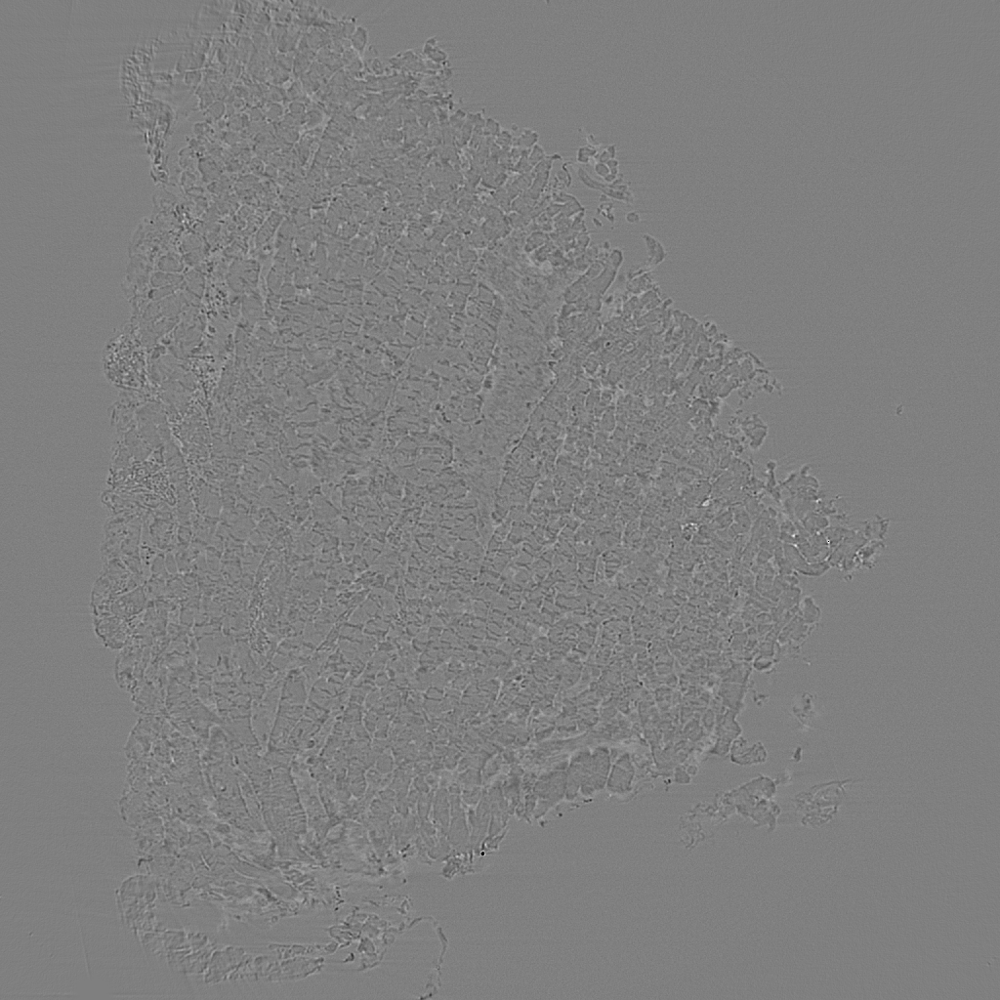

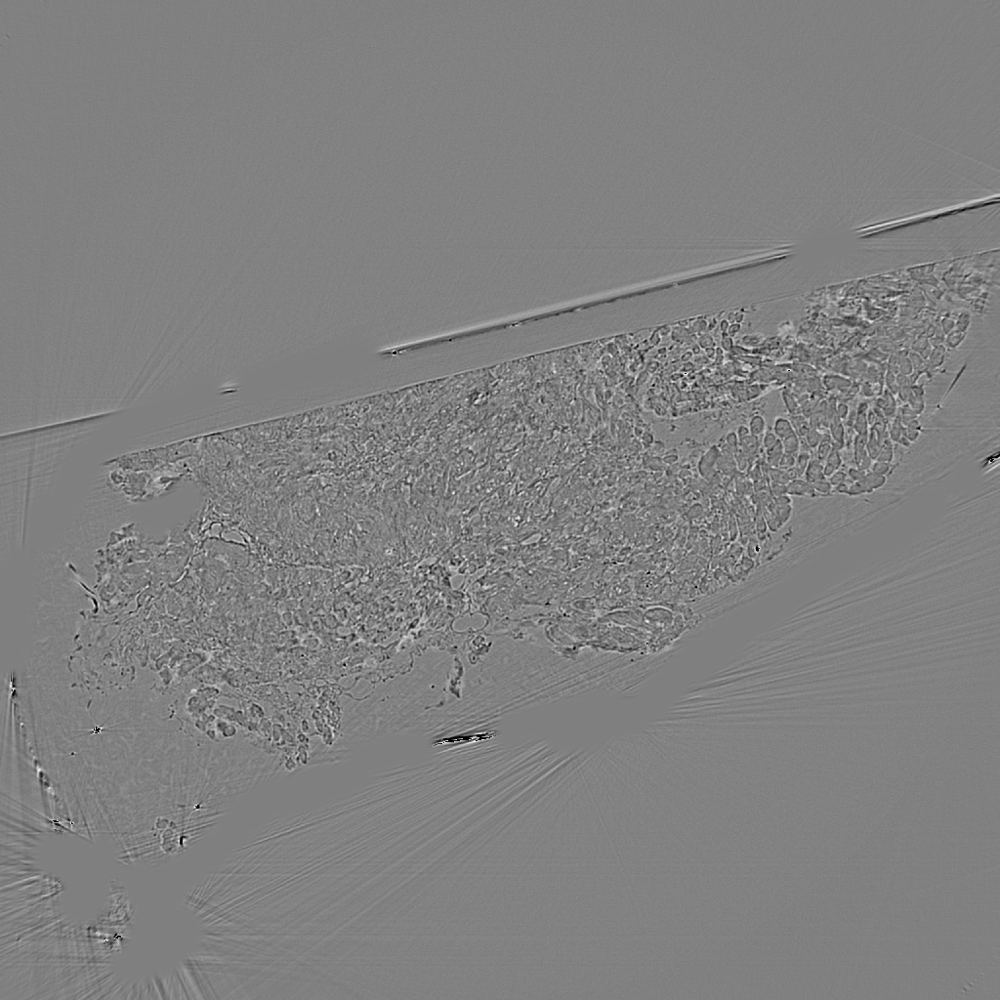

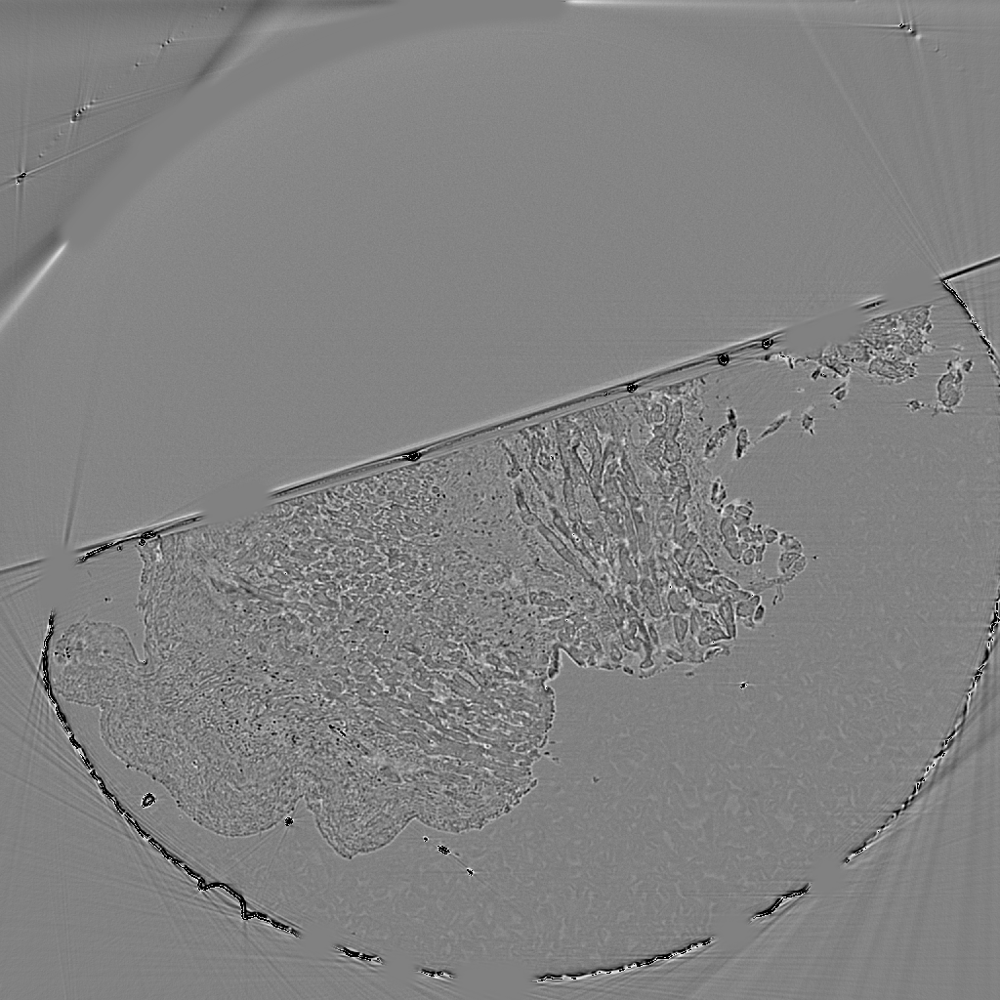

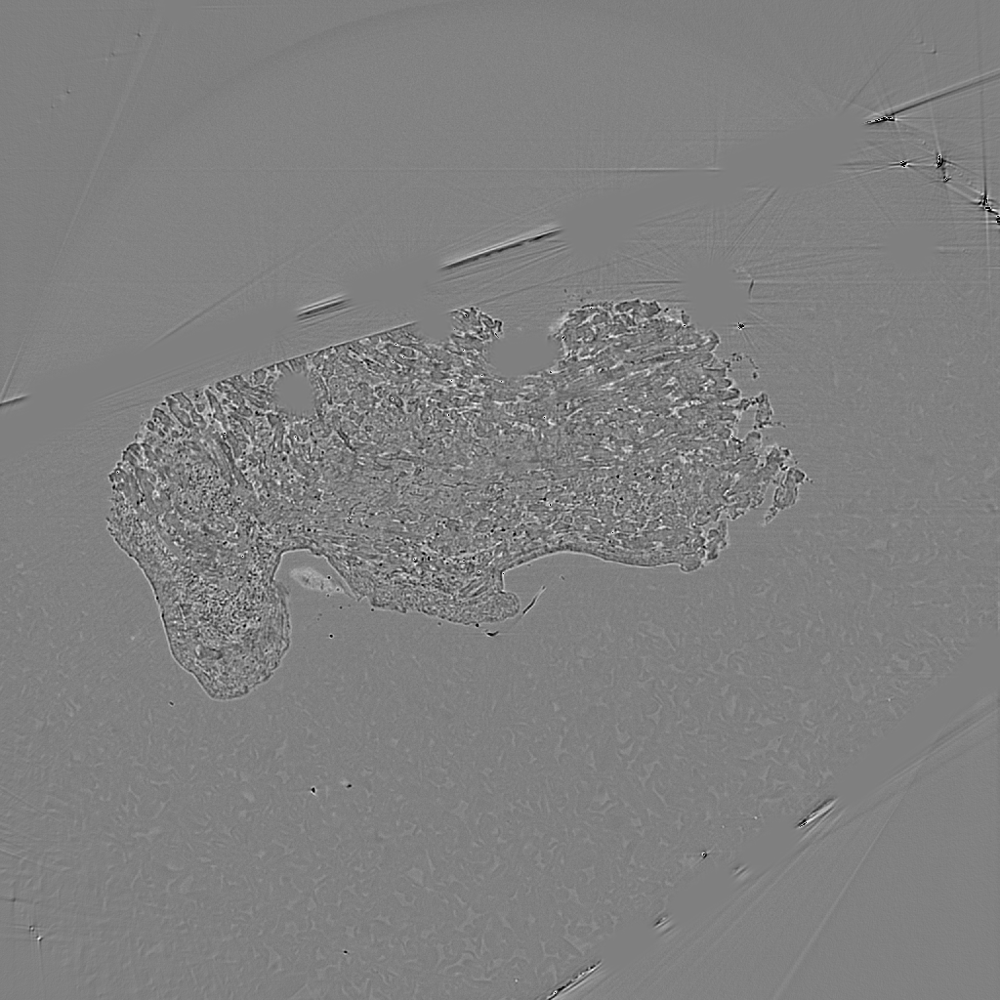

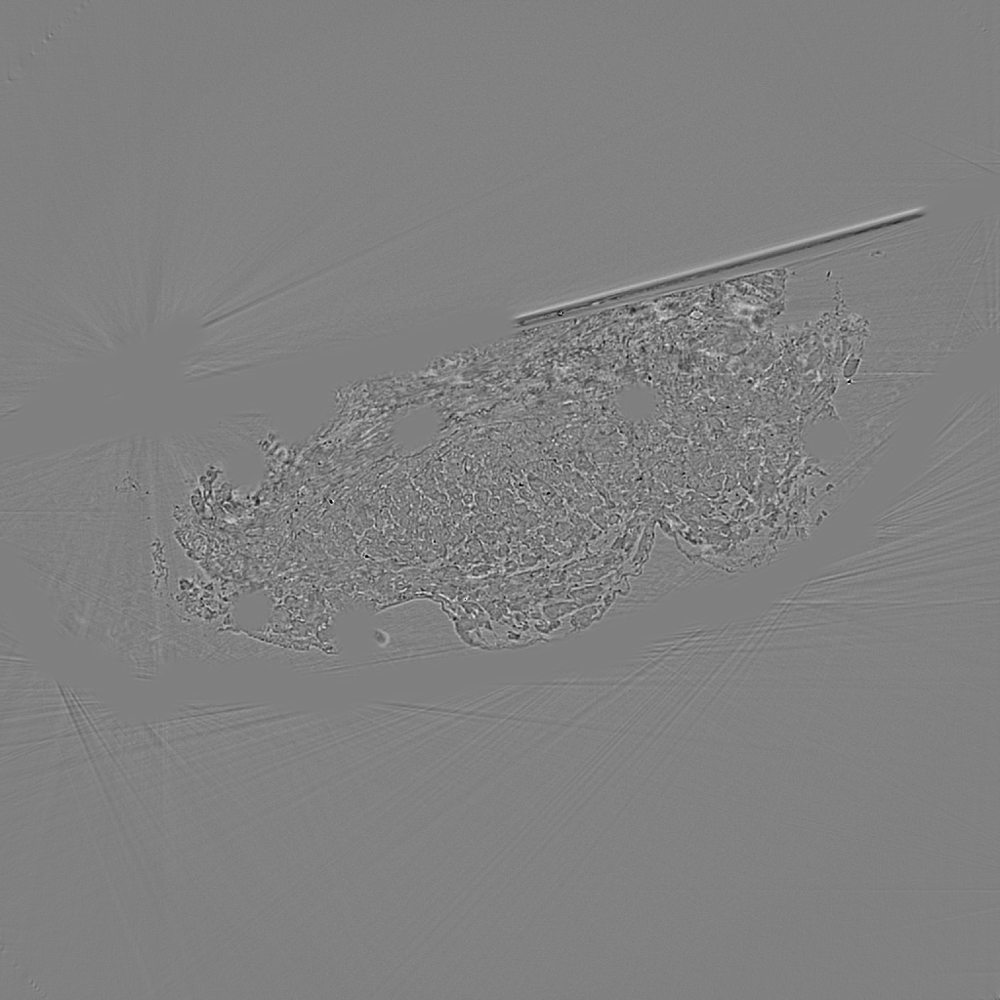

val


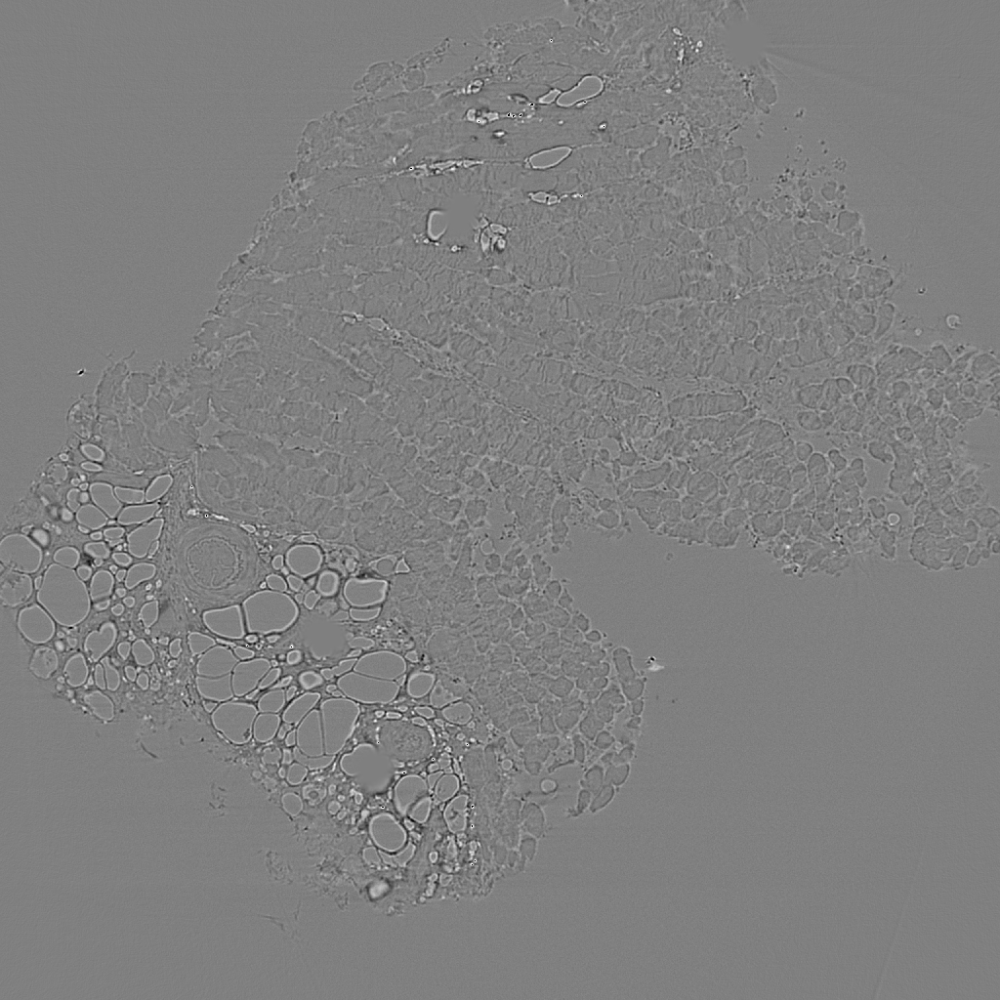

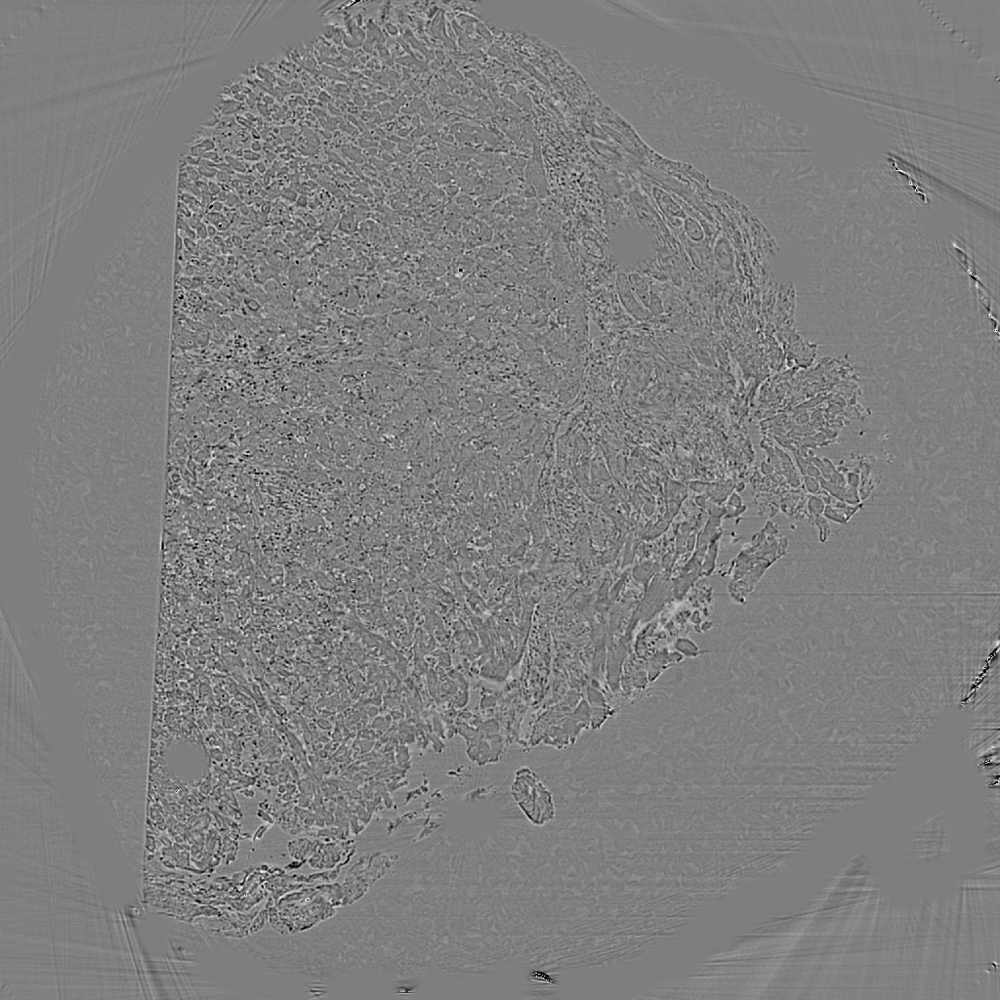

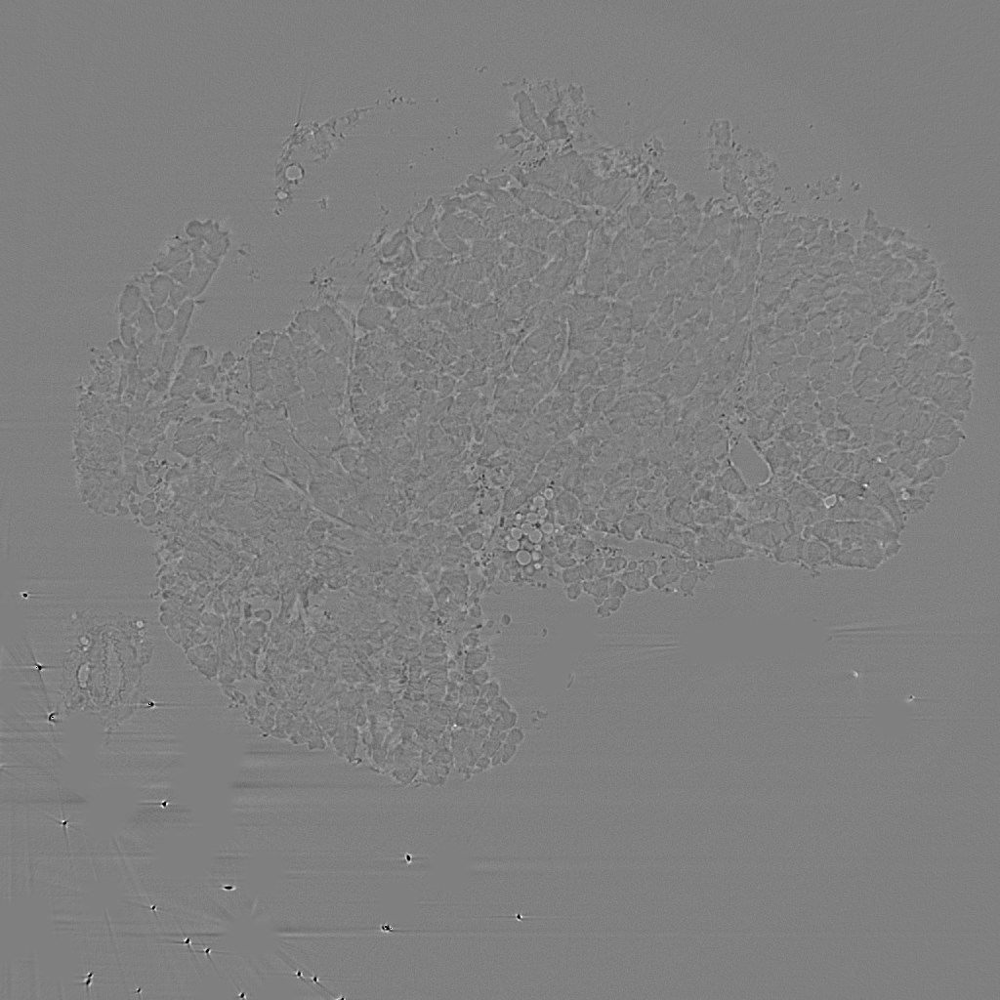

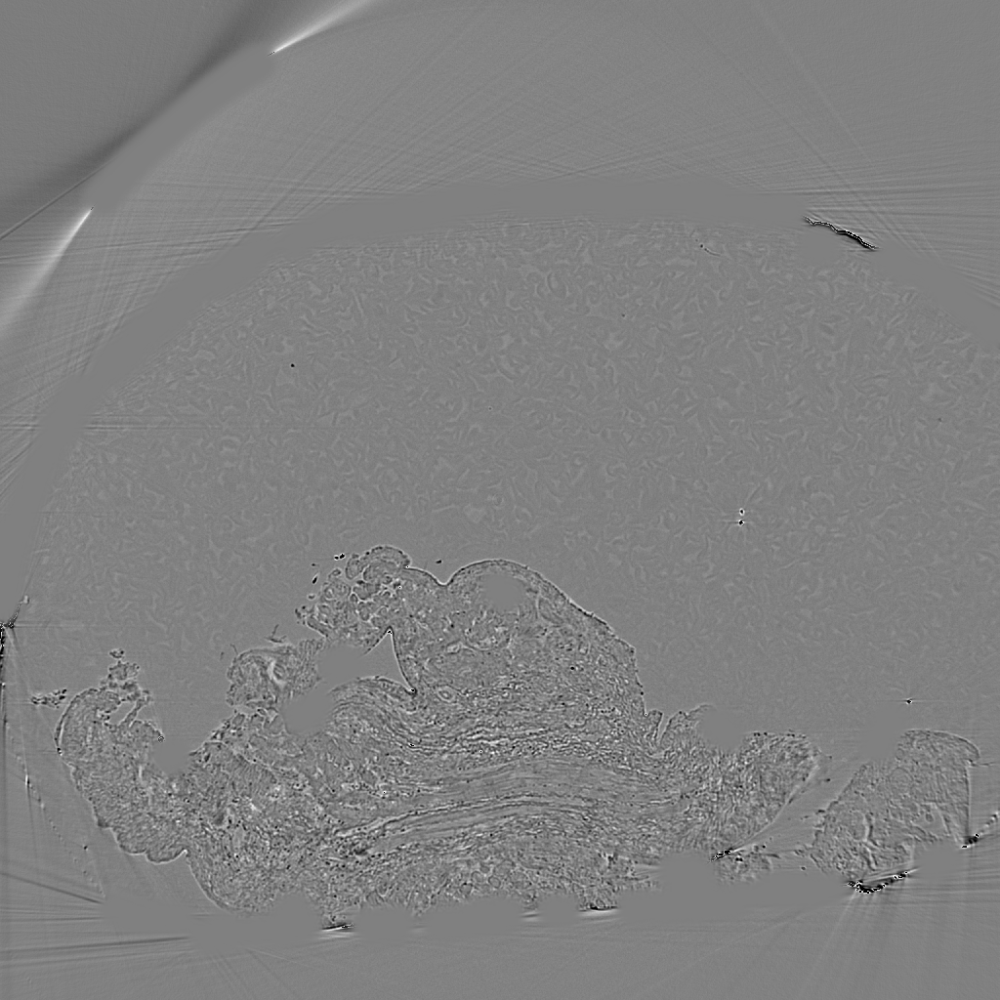

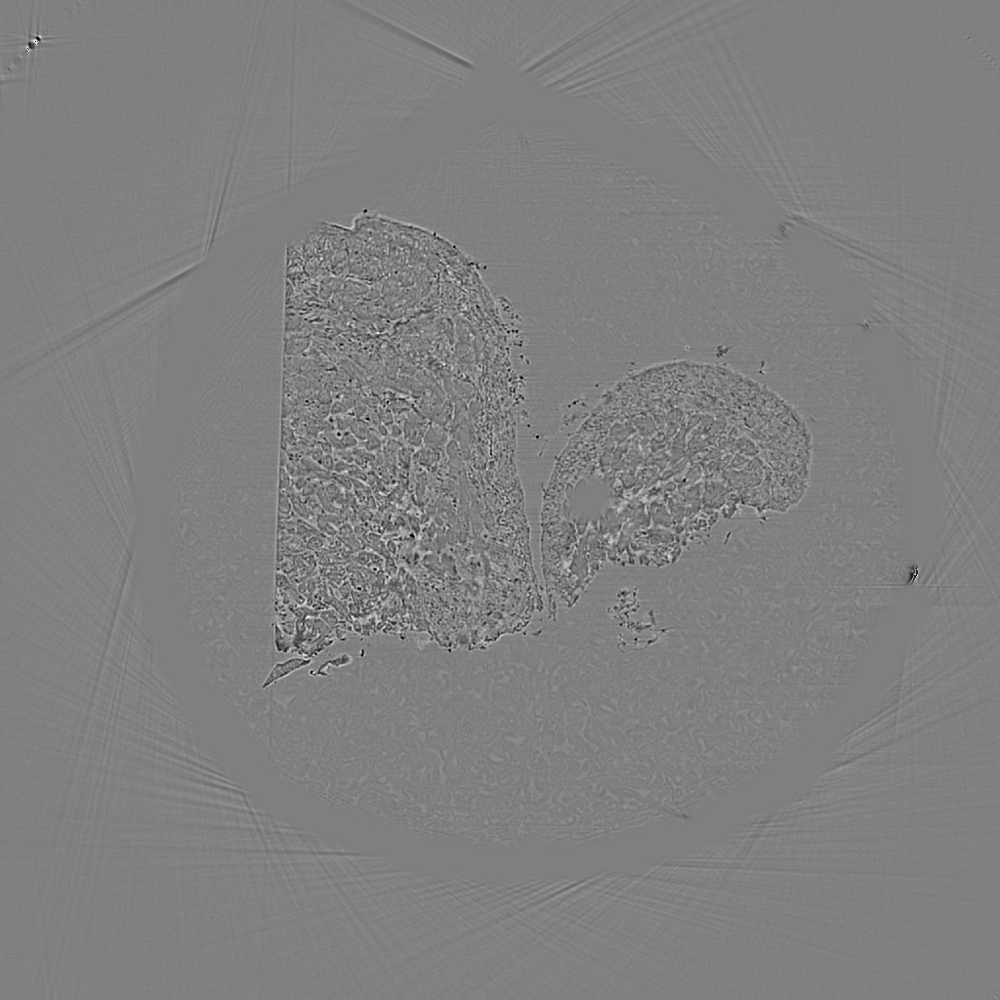

In [274]:
root_directory = '/home/datasets/dataset_biopsies_small2'
biopsies_list_path = 'image_paths/train_image_paths.txt'
with open(biopsies_list_path, 'r') as file:
    biopsies_list = file.readlines()
image_paths['abc'] = random.sample(biopsies_list, 5)
image_paths['abc'] = [os.path.join(root_directory, line.strip()) for line in image_paths['abc']]

for image_path in image_paths['abc']:
    img = Image.open(image_path)
    img.show()
    
print("val")
biopsies_list_path = 'image_paths/validation_image_paths.txt'
with open(biopsies_list_path, 'r') as file:
    biopsies_list = file.readlines()
image_paths['abc'] = random.sample(biopsies_list, 5)
image_paths['abc'] = [os.path.join(root_directory, line.strip()) for line in image_paths['abc']]

for image_path in image_paths['abc']:
    img = Image.open(image_path)
    img.show()